### Run subclusters among Myeloid subtypes and differential analysis across Myeloid cells from four datasets

In [1]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import numpy as np
import scirpy as ir
import matplotlib as mpl
import matplotlib.ticker as ticker
mpl.rcParams['font.family'] = 'Arial'
figPath = "figure-1.23"
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14

/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(


In [186]:
wdata = sc.read_h5ad("New_018.h5ad")
wdata

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 50000 × 21864
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells', 'UCe

In [187]:
wdata.obs['annotation'].cat.categories

Index(['B cell', 'CD4+ T cell', 'CD8+ T cell', 'Cancer Basal',
       'Cancer Epithelial', 'Endothelial', 'Fibroblast', 'Keratinocyte',
       'Macrophage', 'Monocyte', 'NK cell', 'Normal Epithelial', 'Pericyte',
       'Plasma', 'Plasmablast', 'Treg'],
      dtype='object')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


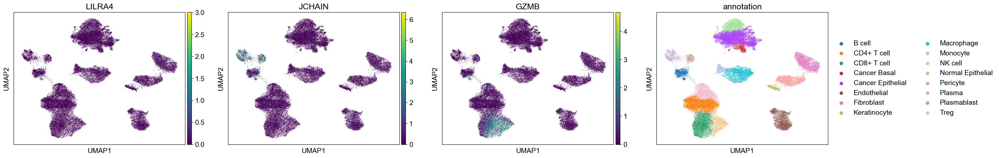

In [189]:
sc.pl.umap(wdata, color=['LILRA4', 'JCHAIN', 'GZMB', 'annotation'])

In [ ]:
wdata.obs['annotation'].cat.categories

Index(['B cell', 'CD4+ T cell', 'CD8+ T cell', 'Cancer Basal',
       'Cancer Epithelial', 'Endothelial', 'Fibroblast', 'Keratinocyte',
       'Macrophage', 'Monocyte', 'NK cell', 'Normal Epithelial', 'Pericyte',
       'Plasma', 'Plasmablast', 'Treg'],
      dtype='object')

In [190]:
adata_OBC_exter_Mye = wdata[wdata.obs['annotation'].isin(['Macrophage', 'Monocyte', 'B cell'])]

In [ ]:
adata_OBC_exter_Stromal = wdata[wdata.obs['annotation'].isin(['Pericyte','Fibroblast', 'Endothelial'])]

In [ ]:
adata_OBC_exter_Stromal.write_h5ad("adata-OBC-exter-Stromal-4.22.h5ad")

In [646]:
adata_Fib = sc.read_h5ad('adata-FFib.h5ad')
adata_Fib

AnnData object with n_obs × n_vars = 37345 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'leiden-Fib', 'Fib-type'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Fib-type_colors', 'batch_colors', 'dendrogram_Fib-type', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-Fib_colors', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_color

In [649]:
adata_Fib.obs['anno-Fib'] = adata_Fib.obs['Fib-type']
adata_Fib.write_h5ad("adata-YBC-native-Fib-4.21.h5ad")

In [2]:
def clu(adata, key_added="majorType-fix", 
        n_neighbors=50, n_pcs=30, 
        rep='X_pca_harmony', 
        do_har=False, 
        max_iter=20, 
        do_scrublet=False, 
        har_key='batch', 
        resolution=1):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
    if do_har and len(adata.obs[har_key].cat.categories) > 1:
        sc.external.pp.harmony_integrate(adata, key=har_key,max_iter_harmony=max_iter)
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    else:
        print("Evaluating neighbors only...")
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=resolution, key_added=key_added)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


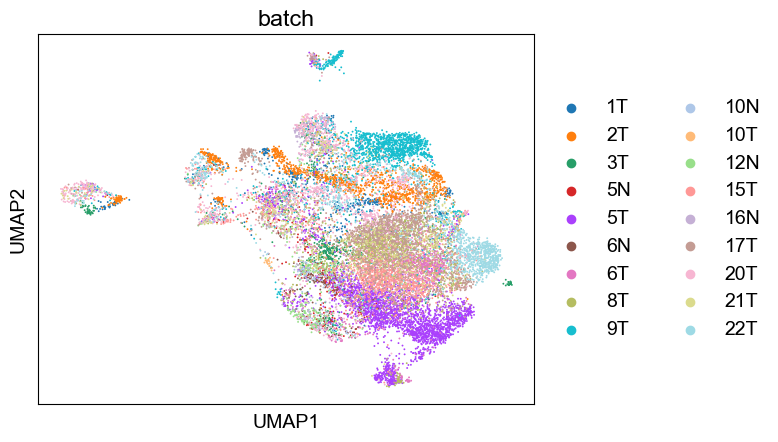

In [ ]:
adata_YBC_native_Mye = sc.read_h5ad("adata-Fmye1.h5ad")
sc.pl.umap(adata_YBC_native_Mye, color=['batch'])

In [101]:
# 自定义加权欧氏距离计算器
class AnomalyAwareDistance:
    def __init__(self, alpha=1.0, epsilon=1e-8):
        self.alpha = alpha
        self.epsilon = epsilon  # 数值稳定系数
        
    def _safe_zscore(self, X):
        """带数值稳定的Z-Score计算"""
        mean = np.nanmean(X, axis=0)
        std = np.nanstd(X, axis=0)
        std = np.where(std < self.epsilon, self.epsilon, std)
        return np.abs((X - mean) / std)
    
    def _robust_weights(self, X):
        """带异常处理的权重计算"""
        z_scores = self._safe_zscore(X)
        weights = np.power(z_scores, self.alpha)
        
        # 处理全零权重列
        max_weights = np.max(weights, axis=0)
        max_weights = np.where(max_weights == 0, 1, max_weights)
        return weights / max_weights
    
    def __call__(self, u, v):
        X = np.vstack([u, v])
        weights = self._robust_weights(X)
        final_weights = np.max(weights, axis=0)
        return np.sqrt(np.nansum(final_weights * (u - v)**2))

In [227]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
import matplotlib.pyplot as plt
groupby='batch'
clusters='leiden-Mye'
key_added='group'
adata = adata_YBC_native_Mye_origin
def get_batch_groups(adata, groupby:str, clusters:str, key_added:str):
    barlabels = adata.obs[groupby].cat.categories
    cell_types = adata.obs[clusters].cat.categories
    age_df = pd.DataFrame(columns = list(cell_types))
    for bar in barlabels:
        d1 = pd.DataFrame([len(adata[(adata.obs[clusters] == ct) & (adata.obs[groupby] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
        age_df = pd.concat([age_df, d1])
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    scaler = StandardScaler()
    age_scaledf = scaler.fit_transform(age_normdf)
    age_scaledf = pd.DataFrame(age_scaledf, columns=age_normdf.columns, index = age_normdf.index)
    age_scaledf = age_scaledf.T
    # 创建自定义距离计算器
    custom_dist = AnomalyAwareDistance(alpha=2.0)

    # 计算距离矩阵
    distance_matrix = pdist(age_scaledf.T, metric=custom_dist)

    # 执行层次聚类
    Z = linkage(distance_matrix, method='ward')

    # 可视化树状图
    plt.figure(figsize=(10, 6))
    gr = dendrogram(Z, 
                    color_threshold=0.5*max(Z[:,2]),
                    labels=age_scaledf.columns.tolist(),
                    leaf_font_size=12)
    plt.show()

    annot = {}
    for i, batch in enumerate(gr['ivl']):
        if gr['leaves_color_list'][i] in annot.keys():
            annot[gr['leaves_color_list'][i]].append(batch)
        else:
            annot[gr['leaves_color_list'][i]] = [batch]
    adata = anno(adata, annot, key_added, groupby)
    adata.obs[key_added] = adata.obs[key_added].astype('category')
    return adata

In [ ]:
def evalRefinedGroups(adata_YBC_native_Mye_origin, clusters='leiden',groupby='batch', key_added='group'):
  # eval correlation among batches in clusters
  pass

Ignoring processing doublet cells...


2025-04-08 09:11:33,883 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-08 09:11:40,782 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-08 09:11:40,855 - harmonypy - INFO - Iteration 1 of 20
2025-04-08 09:11:43,742 - harmonypy - INFO - Iteration 2 of 20
2025-04-08 09:11:46,766 - harmonypy - INFO - Iteration 3 of 20
2025-04-08 09:11:49,784 - harmonypy - INFO - Iteration 4 of 20
2025-04-08 09:11:52,693 - harmonypy - INFO - Iteration 5 of 20
2025-04-08 09:11:55,525 - harmonypy - INFO - Iteration 6 of 20
2025-04-08 09:11:57,623 - harmonypy - INFO - Converged after 6 iterations
/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatter

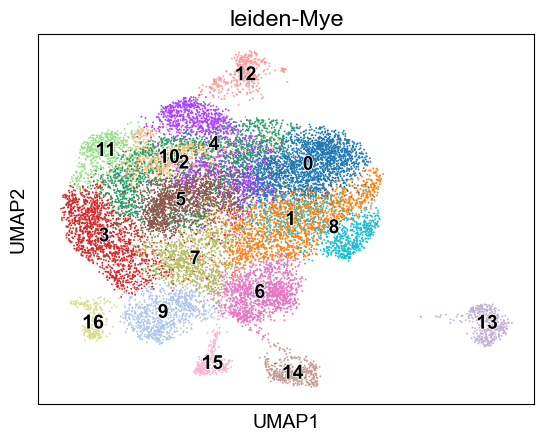

In [7]:
adata_YBC_native_Mye.obs['tech'] = '5'
adata_YBC_native_Mye.obs.loc[adata_YBC_native_Mye.obs['sample'].isin(['1T', '2T', '3T']), 'tech'] = '3'
adata_YBC_native_Mye.obs['tech'] = adata_YBC_native_Mye.obs['tech'].astype('category')
adata_YBC_native_Mye = clu(adata_YBC_native_Mye, 'leiden-Mye', n_pcs=30, har_key='tech', do_har=True, resolution=1)

Ignoring processing doublet cells...


2025-05-04 02:34:28,885 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-04 02:34:35,739 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-04 02:34:35,820 - harmonypy - INFO - Iteration 1 of 20
2025-05-04 02:34:39,764 - harmonypy - INFO - Iteration 2 of 20
2025-05-04 02:34:43,556 - harmonypy - INFO - Iteration 3 of 20
2025-05-04 02:34:47,394 - harmonypy - INFO - Iteration 4 of 20
2025-05-04 02:34:51,189 - harmonypy - INFO - Iteration 5 of 20
2025-05-04 02:34:54,959 - harmonypy - INFO - Iteration 6 of 20
2025-05-04 02:34:57,586 - harmonypy - INFO - Converged after 6 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


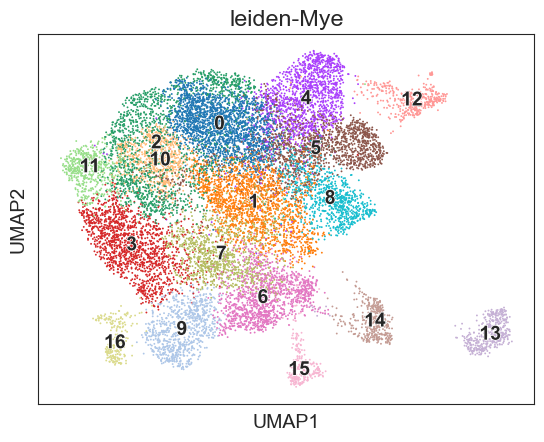

In [664]:
adata_YBC_native_Mye_tech = adata_YBC_native_Mye.copy()
adata_YBC_native_Mye_tech.obs['tech'] = '5'
adata_YBC_native_Mye_tech.obs.loc[adata_YBC_native_Mye_tech.obs['sample'].isin(['1T', '2T', '3T']), 'tech'] = '3'
adata_YBC_native_Mye_tech.obs['tech'] = adata_YBC_native_Mye_tech.obs['tech'].astype('category')
adata_YBC_native_Mye_tech = clu(adata_YBC_native_Mye_tech, 'leiden-Mye', n_pcs=30, har_key='tech', do_har=True, resolution=1)

In [666]:
adata_YBC_native_Mye_tech.write_h5ad("adata-YBC-native-Mye-tech-5.4.h5ad")

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


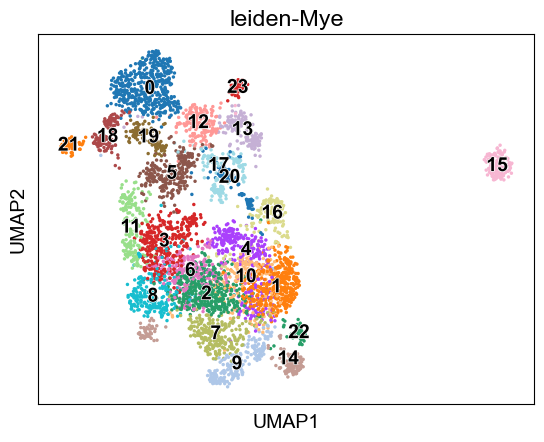

In [199]:
adata_OBC_exter_Mye = clu(adata_OBC_exter_Mye, 'leiden-Mye', n_pcs=30, har_key='batch', do_har=False, resolution=2)

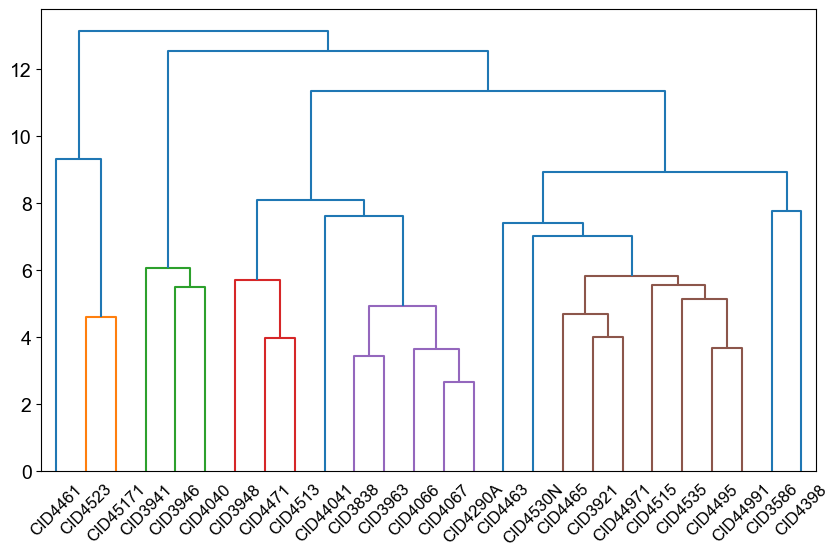

In [228]:
adata_OBC_exter_Mye = get_batch_groups(adata_OBC_exter_Mye, 'batch', 'leiden-Mye', 'groups')

Ignoring processing doublet cells...


2025-04-11 16:06:28,356 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-11 16:06:30,522 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-11 16:06:30,541 - harmonypy - INFO - Iteration 1 of 20
2025-04-11 16:06:31,432 - harmonypy - INFO - Iteration 2 of 20
2025-04-11 16:06:32,322 - harmonypy - INFO - Iteration 3 of 20
2025-04-11 16:06:33,215 - harmonypy - INFO - Iteration 4 of 20
2025-04-11 16:06:33,961 - harmonypy - INFO - Iteration 5 of 20
2025-04-11 16:06:34,492 - harmonypy - INFO - Iteration 6 of 20
2025-04-11 16:06:35,142 - harmonypy - INFO - Iteration 7 of 20
2025-04-11 16:06:35,670 - harmonypy - INFO - Iteration 8 of 20
2025-04-11 16:06:36,256 - harmonypy - INFO - Iteration 9 of 20
2025-04-11 16:06:36,750 - harmonypy - INFO - Iteration 10 of 20
2025-04-11 16:06:37,209 - harmonypy - INFO - Iteration 11 of 20
2025-04-11 16:06:37,668 - harmonypy - INFO - Iteration 12 of 20
2025-04-11 16:06:38,090 - harmonypy - INFO - Iteration 13 of

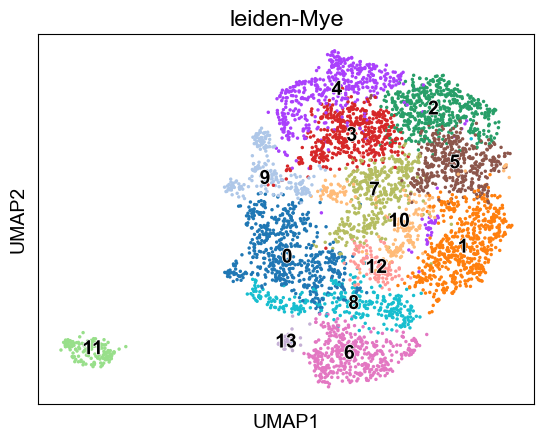

In [ ]:
adata_OBC_exter_Mye = clu(adata_OBC_exter_Mye, 'leiden-Mye', n_pcs=30, har_key='groups', do_har=True, resolution=1)

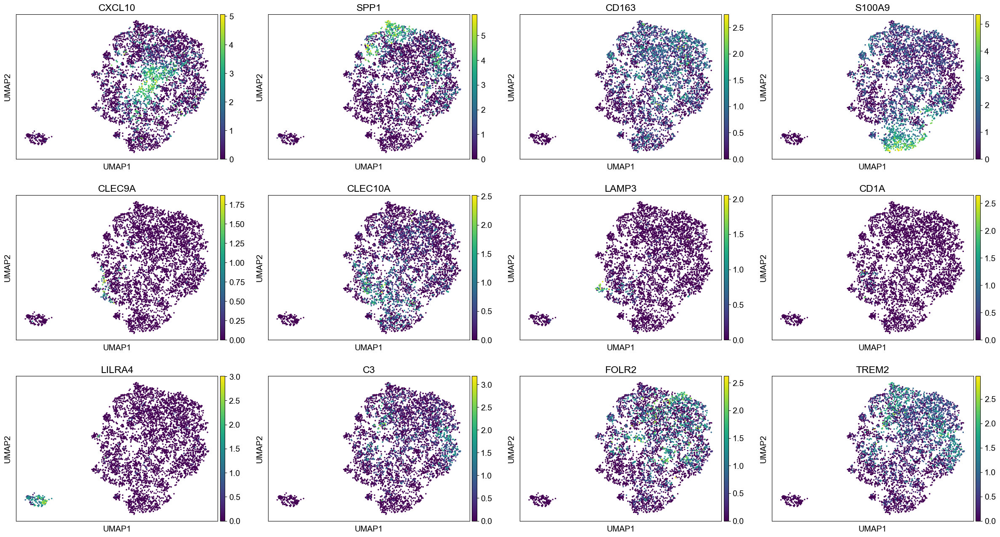

In [230]:
sc.pl.umap(adata_OBC_exter_Mye, color=['CXCL10', 'SPP1', 'CD163', 'S100A9', 'CLEC9A', 'CLEC10A', 'LAMP3', 'CD1A',
                                        'LILRA4', 'C3', 'FOLR2', 'TREM2'])

Ignoring processing doublet cells...


2025-04-11 16:11:07,547 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-11 16:11:09,833 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-11 16:11:09,866 - harmonypy - INFO - Iteration 1 of 20
2025-04-11 16:11:11,243 - harmonypy - INFO - Iteration 2 of 20
2025-04-11 16:11:12,644 - harmonypy - INFO - Iteration 3 of 20
2025-04-11 16:11:14,059 - harmonypy - INFO - Iteration 4 of 20
2025-04-11 16:11:15,225 - harmonypy - INFO - Iteration 5 of 20
2025-04-11 16:11:16,181 - harmonypy - INFO - Iteration 6 of 20
2025-04-11 16:11:17,213 - harmonypy - INFO - Iteration 7 of 20
2025-04-11 16:11:18,116 - harmonypy - INFO - Iteration 8 of 20
2025-04-11 16:11:18,915 - harmonypy - INFO - Iteration 9 of 20
2025-04-11 16:11:19,699 - harmonypy - INFO - Iteration 10 of 20
2025-04-11 16:11:20,384 - harmonypy - INFO - Iteration 11 of 20
2025-04-11 16:11:21,119 - harmonypy - INFO - Iteration 12 of 20
2025-04-11 16:11:21,803 - harmonypy - INFO - Iteration 13 of

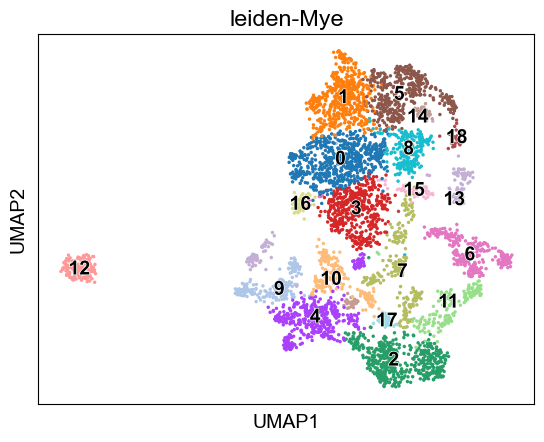

In [233]:
adata_OBC_exter_Mye = clu(adata_OBC_exter_Mye, 'leiden-Mye', n_pcs=30, har_key='batch', do_har=True, resolution=1)

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


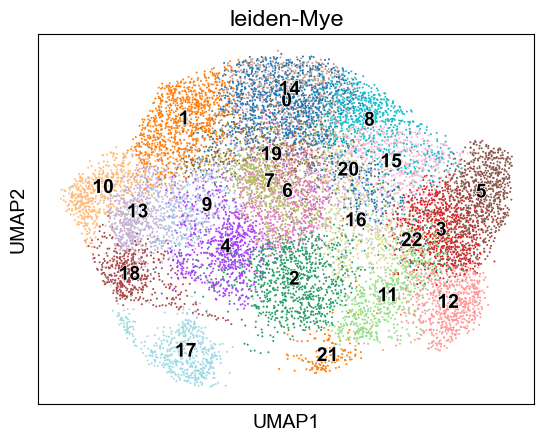

In [247]:
adata_OBC_native_Mye = clu(adata_OBC_native_Mye, 'leiden-Mye', n_pcs=30, har_key='batch', do_har=False, resolution=2)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


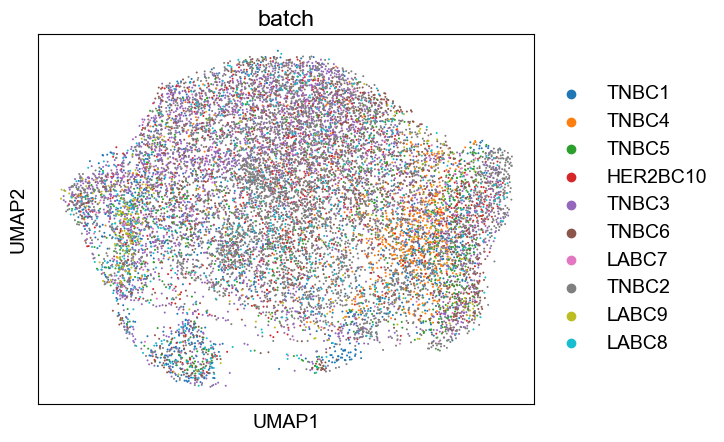

In [249]:
sc.pl.umap(adata_OBC_native_Mye, color=['batch'])

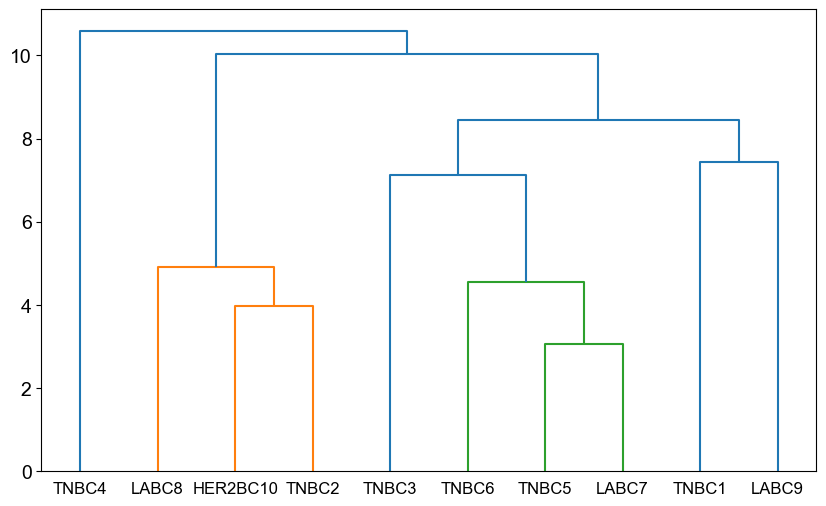

In [248]:
adata_OBC_native_Mye = get_batch_groups(adata_OBC_native_Mye, 'batch', 'leiden-Mye', 'groups')

Ignoring processing doublet cells...


2025-04-11 16:43:04,522 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-11 16:43:10,944 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-11 16:43:11,005 - harmonypy - INFO - Iteration 1 of 20
2025-04-11 16:43:13,766 - harmonypy - INFO - Iteration 2 of 20
2025-04-11 16:43:16,958 - harmonypy - INFO - Converged after 2 iterations


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


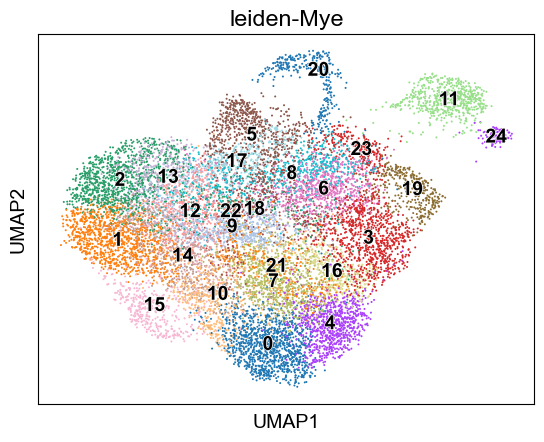

In [257]:
adata_OBC_native_Mye = clu(adata_OBC_native_Mye, 'leiden-Mye', n_pcs=30, har_key='groups', do_har=True, resolution=2)

In [ ]:
import seaborn as sns
annot = {
  "C01_Mac1_SPP1": ['1', '0', '10', '14', '15'],
  "C02_Mac2_CXCL10": ['16'],
  "C03_Mac3_FOLR2": ['21', '7', '12', '13', '2'],
  "C04_Mac4_C3": ['6', '12', '9', '19', '8', '14', '0', '22'],
  "C06_Monocyte": ['9'],
  "C07_Neutrophil": ['23'],
  "C08_cDC1": ['21'],
  "C09_cDC2": ['5'],
  "C10_LC": ['20'],
  "C11_mDC": ['18'],
  "C12_pDC": ['17'],
}
adata_OBC_native_Mye = anno(adata_OBC_native_Mye, annot, 'anno-Mye', 'leiden-Mye')
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
sc.pl.umap(adata_OBC_native_Mye, color=['anno-Mye'], palette='tab20', size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Mye.png', dpi=400, bbox_inches='tight')

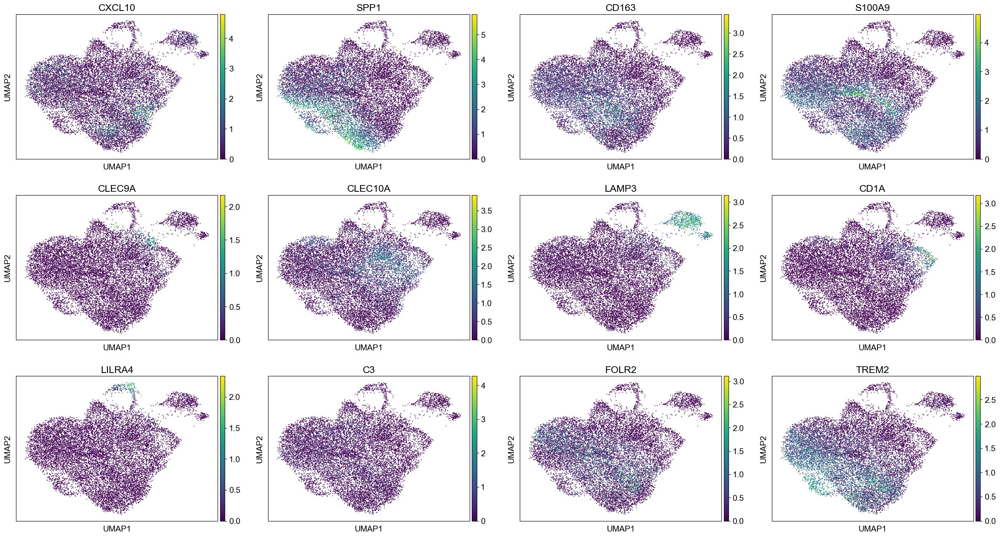

In [327]:
sc.pl.umap(adata_OBC_native_Mye, color=['CXCL10', 'SPP1', 'CD163', 'S100A9', 'CLEC9A', 'CLEC10A', 'LAMP3', 'CD1A',
                                        'LILRA4', 'C3', 'FOLR2', 'TREM2'])

Ignoring processing doublet cells...


2025-04-11 16:38:29,259 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-11 16:38:35,663 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-11 16:38:35,724 - harmonypy - INFO - Iteration 1 of 20
2025-04-11 16:38:39,132 - harmonypy - INFO - Iteration 2 of 20
2025-04-11 16:38:42,548 - harmonypy - INFO - Iteration 3 of 20
2025-04-11 16:38:45,734 - harmonypy - INFO - Iteration 4 of 20
2025-04-11 16:38:48,627 - harmonypy - INFO - Iteration 5 of 20
2025-04-11 16:38:50,645 - harmonypy - INFO - Iteration 6 of 20
2025-04-11 16:38:52,419 - harmonypy - INFO - Iteration 7 of 20
2025-04-11 16:38:54,327 - harmonypy - INFO - Converged after 7 iterations


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


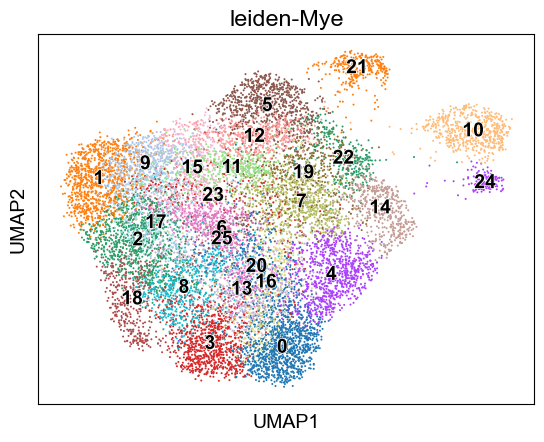

In [254]:
adata_OBC_native_Mye = clu(adata_OBC_native_Mye, 'leiden-Mye', n_pcs=30, har_key='batch', do_har=True, resolution=2)

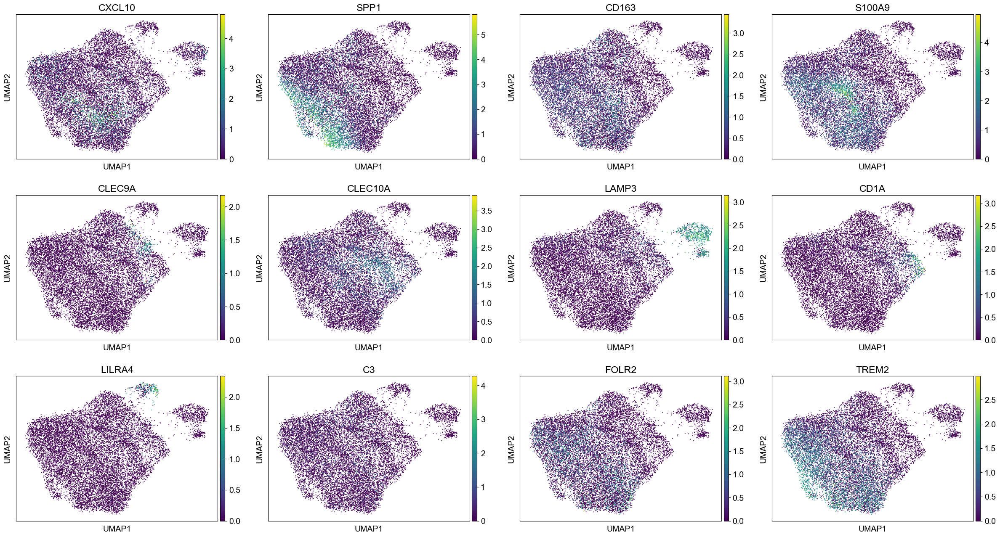

In [255]:
sc.pl.umap(adata_OBC_native_Mye, color=['CXCL10', 'SPP1', 'CD163', 'S100A9', 'CLEC9A', 'CLEC10A', 'LAMP3', 'CD1A',
                                        'LILRA4', 'C3', 'FOLR2', 'TREM2'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


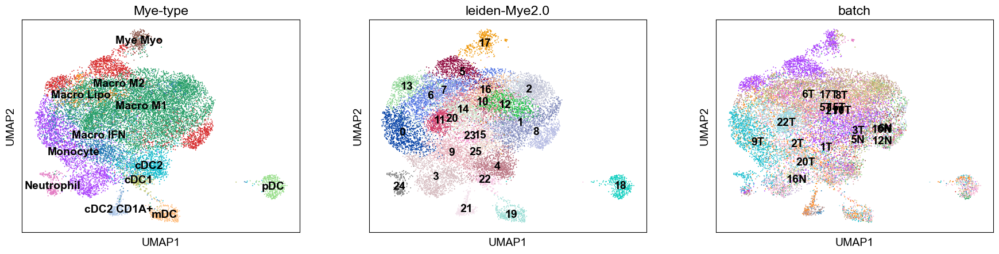

In [ ]:
sc.pl.umap(adata_YBC_native_Mye,color=['Mye-type', 'leiden-Mye2.0'], legend_loc='on data')

Ignoring processing doublet cells...


2025-04-09 10:59:25,102 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-09 10:59:32,161 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-09 10:59:32,230 - harmonypy - INFO - Iteration 1 of 20
2025-04-09 10:59:35,474 - harmonypy - INFO - Iteration 2 of 20
2025-04-09 10:59:38,730 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


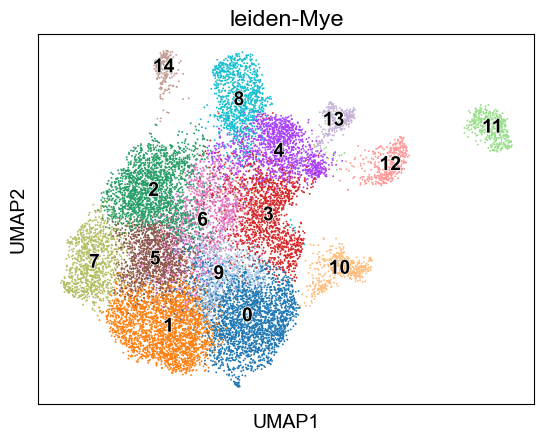

In [127]:
annot = {
  'G1': ['5N', '6N', '10N', '12N', '16N'],
  'G2': ['1T', '2T', '3T'],
  'G3': ['5T'],
  'G4': ['6T', '8T', '10T', '15T', '17T', '20T', '21T',],
  'G5': ['9T'],
  'G6': ['22T'],
}
adata_YBC_native_Mye = anno(adata_YBC_native_Mye, annot, 'har_group', 'batch')
adata_YBC_native_Mye.obs['har_group'] = adata_YBC_native_Mye.obs['har_group'].astype('category')
adata_YBC_native_Mye = clu(adata_YBC_native_Mye, 'leiden-Mye', n_pcs=30, har_key='har_group', do_har=True, resolution=1)

In [129]:
sc.tl.leiden(adata_YBC_native_Mye, key_added='leiden-Mye1.5', resolution=1.5)
sc.tl.leiden(adata_YBC_native_Mye, key_added='leiden-Mye1.8', resolution=1.8)
sc.tl.leiden(adata_YBC_native_Mye, key_added='leiden-Mye2.0', resolution=2.0)

In [137]:
sc.tl.leiden(adata_YBC_native_Mye, key_added='leiden-Mye2.5', resolution=2.5)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


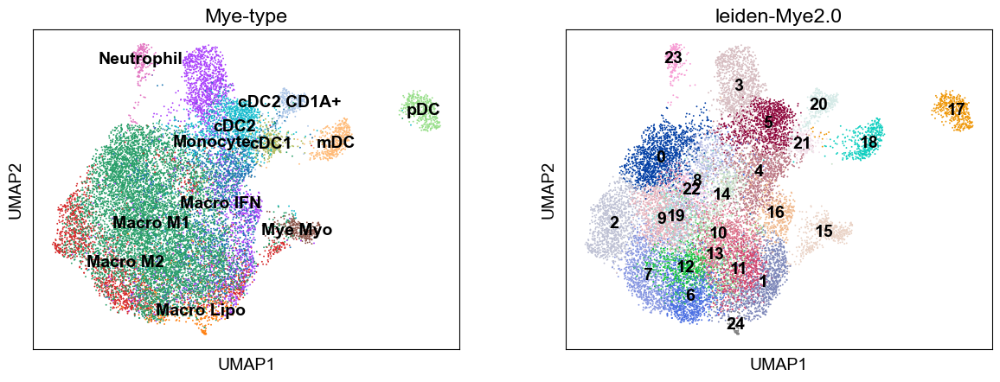

In [140]:
sc.pl.umap(adata_YBC_native_Mye, color=['Mye-type', 'leiden-Mye2.0'], legend_loc='on data')

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


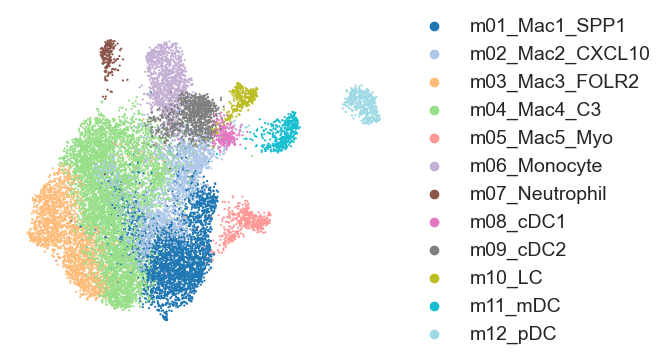

In [689]:
import seaborn as sns
annot = {
  "m01_Mac1_SPP1": ['1', '11', '13', '24', '16'],
  "m02_Mac2_CXCL10": ['4', '10'],
  "m03_Mac3_FOLR2": ['2', '7'],
  "m04_Mac4_C3": ['6', '12', '9', '19', '8', '14', '0', '22'],
  "m05_Mac5_Myo": ['15'],
  "m06_Monocyte": ['3'],
  "m07_Neutrophil": ['23'],
  "m08_cDC1": ['21'],
  "m09_cDC2": ['5'],
  "m10_LC": ['20'],
  "m11_mDC": ['18'],
  "m12_pDC": ['17'],
}
adata_YBC_native_Mye = anno(adata_YBC_native_Mye, annot, 'anno-Mye', 'leiden-Mye2.0')
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
sc.pl.umap(adata_YBC_native_Mye, color=['anno-Mye'], palette='tab20', size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Mye.png', dpi=400, bbox_inches='tight')

In [ ]:
import pandas as pd
import numpy as np
from matplotlib import ticker
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14
def propPlot(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, 0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_xlabel('Cell proportions')
    else:
        ax.yaxis.set_visible(False)
    ax.set_ylabel(xlabel)
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

In [ ]:
sc.pl.palettes.vega_20

['#1f77b4',
 '#aec7e8',
 '#ff7f0e',
 '#ffbb78',
 '#2ca02c',
 '#98df8a',
 '#d62728',
 '#ff9896',
 '#9467bd',
 '#c5b0d5',
 '#8c564b',
 '#c49c94',
 '#e377c2',
 '#f7b6d2',
 '#7f7f7f',
 '#c7c7c7',
 '#bcbd22',
 '#dbdb8d',
 '#17becf',
 '#9edae5']

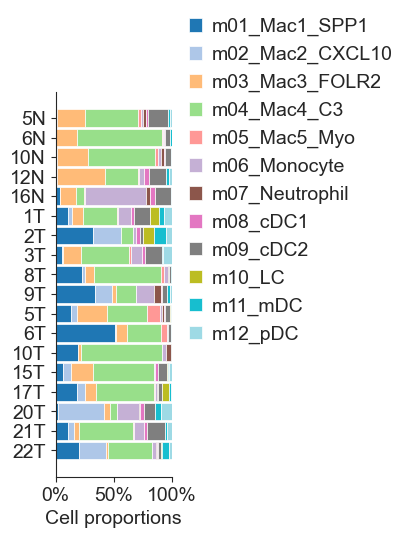

In [690]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
barlabels.reverse()
cell_types = list(adata_YBC_native_Mye.obs['anno-Mye'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 6)
colors = ['#1f77b4', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', 
          '#c5b0d5', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf', '#9edae5']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_YBC_native_Mye.obs["anno-Mye"] == ct) & (adata_YBC_native_Mye.obs["batch"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors= colors)
fig0.savefig(f"{figPath}/Mye_attr_proportions.svg",bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


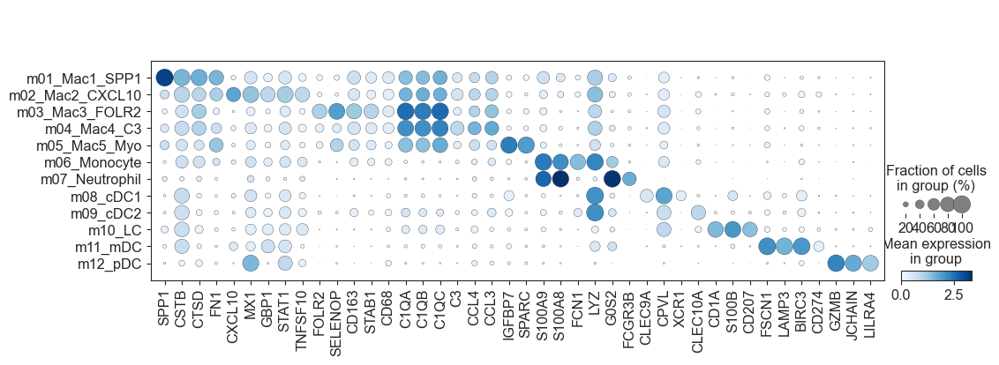

In [743]:
fig, ax = plt.subplots(1,1, figsize=(12,4))
sc.pl.dotplot(adata_YBC_native_Mye, cmap='Blues', groupby='anno-Mye',var_names=[
  'SPP1', 'CSTB', 'CTSD', 'FN1', 'CXCL10', 'MX1', 'GBP1','STAT1', 'TNFSF10',
  'FOLR2', 'SELENOP', 'CD163', 'STAB1','CD68','C1QA', 'C1QB', 'C1QC', 'C3', 'CCL4', 'CCL3', 
  'IGFBP7', 'SPARC', 'S100A9', 'S100A8', 'FCN1', 'LYZ', 'G0S2','FCGR3B', 'CLEC9A', 'CPVL', 'XCR1',
  'CLEC10A', 'CD1A', 'S100B', 'CD207', 'FSCN1', 'LAMP3', 'BIRC3', 'CD274','GZMB', 'JCHAIN', 'LILRA4'
], ax=ax,)
fig.savefig(f"{figPath}/Mye-heatmap.svg", bbox_inches='tight')

In [182]:
adata_OBC_native_Mye = sc.read_h5ad("BCM-Mye.h5ad")
adata_OBC_native_Mye

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 38535 × 28474
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-major', 'major-type'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_leiden-major', 'hvg', 'leiden', 'leiden-major_colors', 'log1p', 'major-type_colors', 'neighbors', 'pca', 'rank_genes_groups', 'scrublet', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [183]:
adata_OBC_native_Mye.write_h5ad('adata-OBC-native-Mye-4.9.h5ad')

In [149]:
adata_YBC_native_Mye.write_h5ad("adata-YBC-native-Mye-4.9.h5ad")

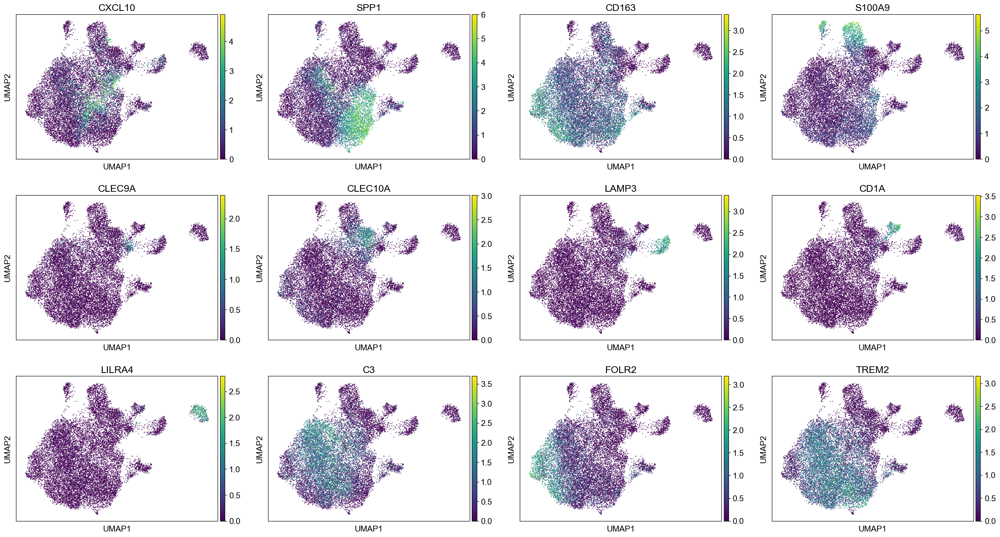

In [142]:
sc.pl.umap(adata_YBC_native_Mye, color=['CXCL10', 'SPP1', 'CD163', 'S100A9', 'CLEC9A', 'CLEC10A', 'LAMP3', 'CD1A',
                                        'LILRA4', 'C3', 'FOLR2', 'TREM2'])

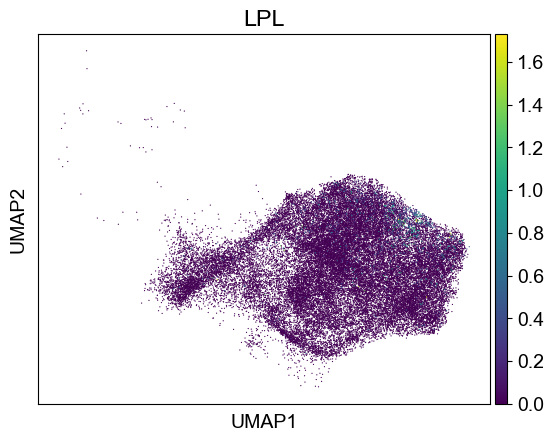

In [235]:
sc.pl.umap(adata_OBC_native_Mye, color=['LPL'])

In [261]:
adata_YBC_exter_Mye = sc.read_h5ad('adata-YBC-exter-Mye-4.9.h5ad')

In [262]:
adata_YBC_native_Mye.obs['attr'] = 'YBC_native'
adata_OBC_native_Mye.obs['attr'] = 'OBC_native'
adata_YBC_exter_Mye.obs['attr'] = 'YBC_exter'
adata_OBC_exter_Mye.obs['attr'] = 'OBC_exter'

In [263]:
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T', ],
  'HR+HER2-': ['5T', '6T', '10T', '15T',],
  'HR+HER2+': ['20T', '21T', '22T',],
  'HR-HER2+': ['17T',],
}
adata_YBC_native_Mye = anno(adata_YBC_native_Mye, annoDict, 'IHC', 'batch')
adata_YBC_native_Mye.obs['IHC'] = adata_YBC_native_Mye.obs['IHC'].astype('category')

# assign IHC
annoDict = {
  'TNBC': ['CID44991', 'CID4513', 'CID4523', 'CID44971', 'CID4495', 'CID4465','CID44041','CID3946','CID4515'],
  'HR+HER2-': ['CID4535', 'CID4067', 'CID4463', 'CID4530N', 'CID4471', 'CID3948','CID4290A','CID4461','CID3941','CID3963','CID4040','CID4398',],
  'HR+HER2+': ['CID4066', 'CID3586',],
  'HR-HER2+': ['CID45171', 'CID3921', 'CID3838'],
}
adata_OBC_exter_Mye = anno(adata_OBC_exter_Mye, annoDict, 'IHC', 'batch')
adata_OBC_exter_Mye.obs['IHC'] = adata_OBC_exter_Mye.obs['IHC'].astype('category')

# assign IHC
annoDict = {
  'TNBC': ['TNB1_0177', 'TNB1_0554', 'TNB1_4031'],
  'HR-HER2+': ['HER2_0308'],
}
adata_YBC_exter_Mye = anno(adata_YBC_exter_Mye, annoDict, 'IHC', 'batch')
adata_YBC_exter_Mye.obs['IHC'] = adata_YBC_exter_Mye.obs['IHC'].astype('category')

# assign IHC
annoDict = {
  'TNBC': ['TNBC1', 'TNBC2', 'TNBC3',
       'TNBC4', 'TNBC5', 'TNBC6'],
  'HR+HER2-': [ 'LABC7', 'LABC8', 'LABC9', ],
  'HR-HER2+': ['HER2BC10']
}
adata_OBC_native_Mye = anno(adata_OBC_native_Mye, annoDict, 'IHC', 'batch')
adata_OBC_native_Mye.obs['IHC'] = adata_OBC_native_Mye.obs['IHC'].astype('category')

In [264]:
adata_YBC_native_Mye.write_h5ad("adata-YBC-native-Mye-4.9.h5ad")
adata_YBC_exter_Mye.write_h5ad("adata-YBC-exter-Mye-4.9.h5ad")
adata_OBC_native_Mye.write_h5ad("adata-OBC-native-Mye-4.9.h5ad")
adata_OBC_exter_Mye.write_h5ad("adata-OBC-exter-Mye-4.9.h5ad")

In [278]:
adata_OBC_native_Mye.obs_names = list(adata_OBC_native_Mye.obs_names)
adata_OBC_native_Mye.obs_names_make_unique()

In [290]:
adata_OBC_native_Mye.var_names_make_unique()

In [292]:
adata1 = adata_YBC_native_Mye
adata2 = adata_OBC_native_Mye
adata3 = adata_YBC_exter_Mye
adata4 = adata_OBC_exter_Mye
adata_Mye = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native','YBC_exter', 'OBC_exter']) #  
adata_Mye

/tmp/ipykernel_626988/2923399830.py:5: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_Mye = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native','YBC_exter', 'OBC_exter']) #


AnnData object with n_obs × n_vars = 40293 × 16902
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-B', 'leiden-Mye', 'Mye-type', 'sample', 'tech', 'leiden-Mye1.5', 'leiden-Mye1.8', 'leiden-Mye2.0', 'har_group', 'leiden-Mye2.5', 'anno-mye', 'anno-Mye', 'attr', 'IHC', 'leiden-major', 'major-type', 'groups', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_G

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


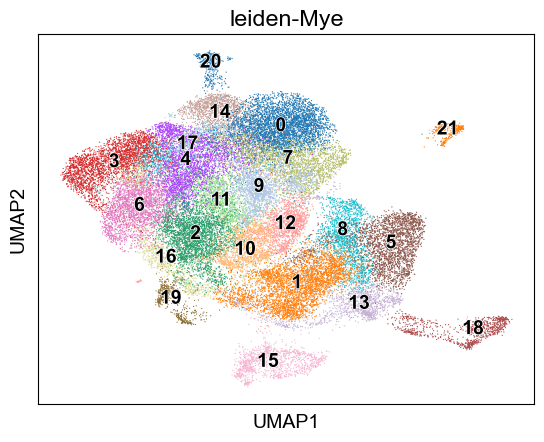

In [293]:
adata_Mye = clu(adata_Mye, key_added='leiden-Mye', rep='X_pca', do_har=False)

Ignoring processing doublet cells...


2025-05-04 02:32:01,568 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-04 02:32:08,668 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-04 02:32:09,110 - harmonypy - INFO - Iteration 1 of 20
2025-05-04 02:32:14,080 - harmonypy - INFO - Iteration 2 of 20
2025-05-04 02:32:18,886 - harmonypy - INFO - Iteration 3 of 20
2025-05-04 02:32:23,651 - harmonypy - INFO - Iteration 4 of 20
2025-05-04 02:32:28,226 - harmonypy - INFO - Iteration 5 of 20
2025-05-04 02:32:32,428 - harmonypy - INFO - Iteration 6 of 20
2025-05-04 02:32:37,144 - harmonypy - INFO - Iteration 7 of 20
2025-05-04 02:32:40,160 - harmonypy - INFO - Iteration 8 of 20
2025-05-04 02:32:42,773 - harmonypy - INFO - Iteration 9 of 20
2025-05-04 02:32:45,573 - harmonypy - INFO - Iteration 10 of 20
2025-05-04 02:32:48,413 - harmonypy - INFO - Iteration 11 of 20
2025-05-04 02:32:50,706 - harmonypy - INFO - Iteration 12 of 20
2025-05-04 02:32:53,038 - harmonypy - INFO - Iteration 13 of

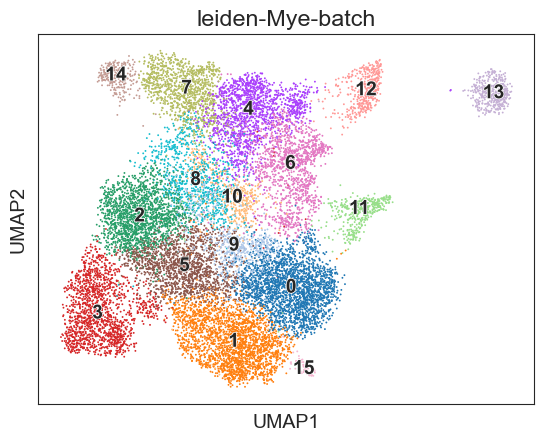

In [663]:
adata_YBC_native_Mye_batch = adata_YBC_native_Mye.copy()
adata_YBC_native_Mye_batch = clu(adata_YBC_native_Mye_batch, key_added='leiden-Mye-batch', rep='X_pca_harmony', do_har=True)

In [665]:
adata_YBC_native_Mye_batch.write_h5ad("adata-YBC-native-Mye-batch-5.4.h5ad")

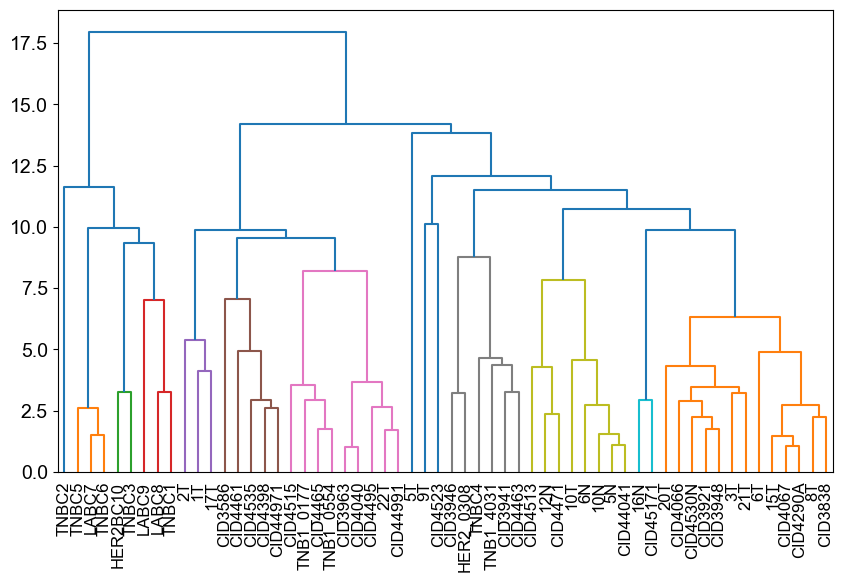

In [295]:
adata_Mye = get_batch_groups(adata_Mye, 'batch', 'leiden-Mye', 'groups')

Ignoring processing doublet cells...


2025-04-11 17:14:23,858 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-11 17:14:37,891 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-11 17:14:38,085 - harmonypy - INFO - Iteration 1 of 20
2025-04-11 17:14:47,475 - harmonypy - INFO - Iteration 2 of 20
2025-04-11 17:14:56,786 - harmonypy - INFO - Iteration 3 of 20
2025-04-11 17:15:06,313 - harmonypy - INFO - Iteration 4 of 20
2025-04-11 17:15:15,552 - harmonypy - INFO - Iteration 5 of 20
2025-04-11 17:15:23,791 - harmonypy - INFO - Converged after 5 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


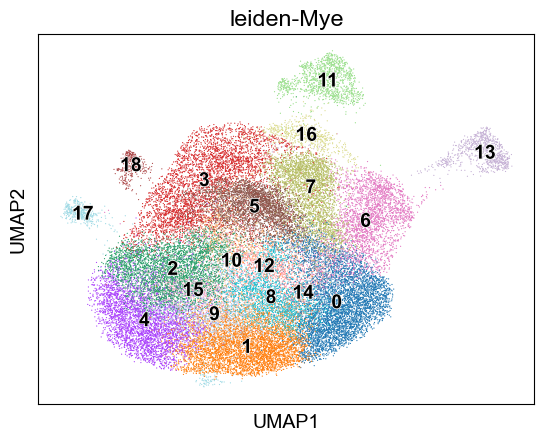

In [296]:
adata_Mye = clu(adata_Mye, key_added='leiden-Mye',  do_har=True, har_key='groups')

In [305]:
sc.tl.leiden(adata_Mye, key_added='leiden-1.5', resolution=1.5)
sc.tl.leiden(adata_Mye, key_added='leiden-1.7', resolution=1.7)
sc.tl.leiden(adata_Mye, key_added='leiden-1.8', resolution=1.8)
sc.tl.leiden(adata_Mye, key_added='leiden-2.0', resolution=2.0)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


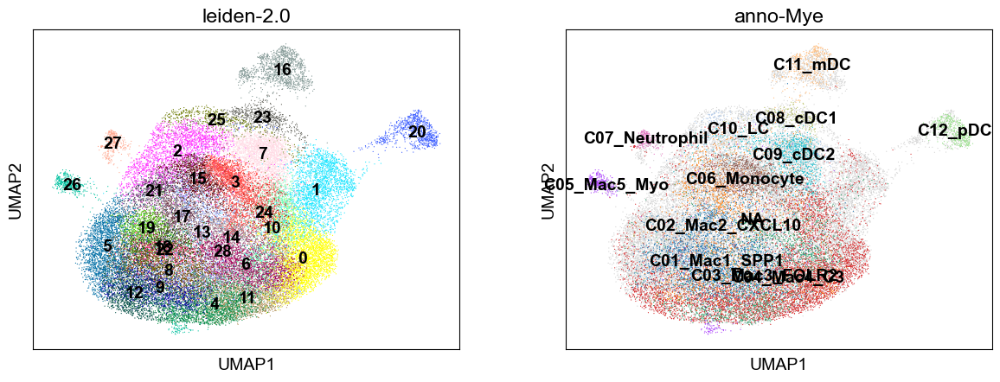

In [309]:
sc.pl.umap(adata_Mye, color=['leiden-2.0', 'anno-Mye'], legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


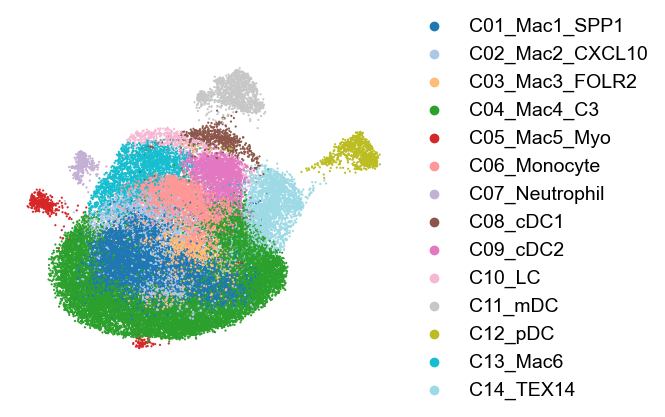

In [339]:
import seaborn as sns
annot = {
  "C01_Mac1_SPP1": ['6', '8', '19', '18', '22', '17', '28'],
  "C02_Mac2_CXCL10": ['13', '21'],
  "C03_Mac3_FOLR2": ['14'],
  "C04_Mac4_C3": ['5', '12', '4', '11', '0', '10', '24', '9'],
  "C05_Mac5_Myo": ['26'],
  "C06_Monocyte": ['3', '15'],
  "C07_Neutrophil": ['27'],
  "C08_cDC1": ['23'],
  "C09_cDC2": ['7'],
  "C10_LC": ['25'],
  "C11_mDC": ['16'],
  "C12_pDC": ['20'],
  "C13_Mac6": ['2'],
  'C14_TEX14':['1']
}
adata_Mye = anno(adata_Mye, annot, 'anno-Mye-all', 'leiden-2.0')
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
sc.pl.umap(adata_Mye, color=['anno-Mye-all'], palette='tab20', size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Mye-all.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initial

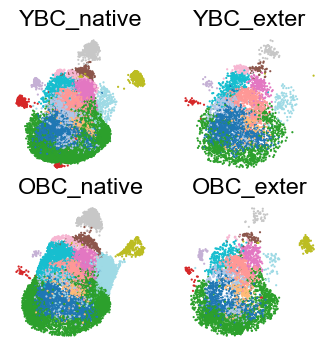

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
for i, attr in enumerate(['YBC_native', 'YBC_exter', 'OBC_native', 'OBC_exter']):
  x, y = int(i/2), i%2
  sc.pl.umap(adata_Mye[adata_Mye.obs['attr']==attr], color=['anno-Mye-all'],
             palette='tab20', size=10,title=attr, ax=ax[x][y], show=False)
  ax[x][y].spines['right'].set_visible(False)
  ax[x][y].spines['top'].set_visible(False)
  ax[x][y].spines['left'].set_visible(False)
  ax[x][y].spines['bottom'].set_visible(False)
  ax[x][y].set_xlabel("")
  ax[x][y].set_ylabel("")
  ax[x][y].legend_.set_visible(False)
  fig.savefig(f'{figPath}/Mye_batch.png', dpi=400, bbox_inches='tight')

In [350]:
annot = {
  'Young': ['YBC_native', 'YBC_exter'],
  'Non-young': ['OBC_native', 'OBC_exter']
}
adata_Mye = anno(adata_Mye, annot, 'age', 'attr')

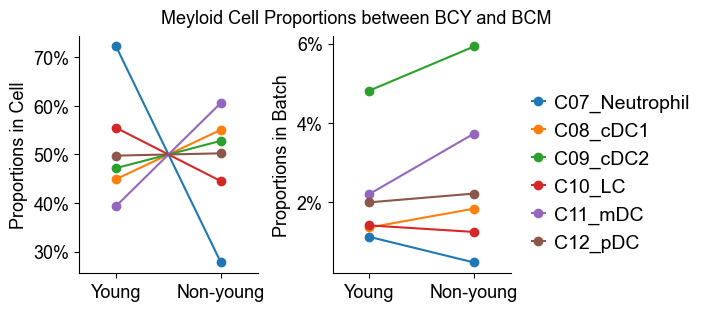

In [354]:
import matplotlib.pyplot as plt
from matplotlib import ticker
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 13

from collections import Counter
def propByCell(adata, group, key, batch):
    groups = adata.obs[batch][adata.obs[group]==key]
    props = Counter(groups)
    all = sum(props.values())
    for item in props.keys():
        props[item] = (props[item] / all)
    return props

def propByBatch(adata, group, key, batch):
    groups = adata.obs[batch][adata.obs[group]==key]
    props = Counter(groups)
    for item in props.keys():
        props[item] = (props[item] / sum(adata.obs[batch]==item))
    return props

def propPlot(adata, ax, group, keys, diff, mode='Cell', showLegend=True):
    if mode=='Cell':
        fn=propByCell
    else:
        fn=propByBatch
    for key in keys:
        props = fn(adata, group, key, diff)
        y=list(props.values())
        x=list(props.keys())
        ax.plot(x, y, marker='o', label=key)
        bar=list(props.keys())
    ax.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
    ax.set_ylabel('Proportions in {}'.format(mode))
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)
    ax.set_xlim(-0.35,1.35)
    if showLegend:
        ax.legend( bbox_to_anchor=(1, 0), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.6,
                          columnspacing=1.3,
                          handlelength=0.65,
              loc='lower left', fontsize=14)
fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(7, 3),constrained_layout=True)
propPlot(adata_Mye, ax[0], 'anno-Mye-all', 
         ['C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC', ], 'age', showLegend=False)
propPlot(adata_Mye, ax[1], 'anno-Mye-all', ['C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC', ], 'age', mode="Batch")
fig.suptitle("Meyloid Cell Proportions between BCY and BCM", fontsize=13)
fig.show()
# fig.savefig("Myeloid-Cell-prop-plot.svg", bbox_inches='tight')

In [355]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [356]:
anndata2ri.activate()

/tmp/ipykernel_626988/4016445965.py:1: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [357]:
%load_ext rpy2.ipython

In [358]:
def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

def prepare_miloR(adata:ad.AnnData, conDict:dict, condName, condVal, batch='batch'):
  adata_no_knn = adata.copy()
  adata_no_knn.obsp = None
  adata_no_knn.uns.pop("neighbors")
  adata_no_knn = anno(adata_no_knn, annoDict=conDict, obsKey=condName, obsVal=condVal, default=None)
  adata_no_knn.obs[condName] = adata_no_knn.obs[condName].astype('category')
  used_cond = adata_no_knn.obs[condName].cat.categories
  adata_no_knn = adata_no_knn[adata_no_knn.obs[condName].isin(used_cond)]  # only use conditions condDict 
  print(adata_no_knn.obs[condName].cat.categories)
  knn_adjacency = adata.obsp["connectivities"]
  design_df = adata_no_knn.obs[[batch,condName]]
  design_df.drop_duplicates(inplace=True)
  design_df.index = design_df['batch']
  return adata_no_knn, knn_adjacency, design_df

In [363]:
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Mye-all', 'age', 'TorN']]

In [692]:
adata_Mye.obs['anno-Mye-all'].cat.categories

Index(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',
       'C05_Mac5_Myo', 'C06_Monocyte', 'C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC', 'C13_Mac6', 'C14_TEX14'],
      dtype='object')

In [727]:
conDict = {
  'left': ['OBC_native', ],
  'right': ['YBC_native', ]
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_Mye[adata_Mye.obs['anno-Mye-all'].isin(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',])], conDict, 'TorN', 'attr', )
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Mye-all', 'attr', 'age','TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_626988/2067485073.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 19290 × 16902
    obs: 'batch', 'anno-Mye-all', 'attr', 'age', 'TorN'
    var: 'n_cells-OBC_exter', 'highly_variable-OBC_exter', 'means-OBC_exter', 'dispersions-OBC_exter', 'dispersions_norm-OBC_exter', 'type-OBC_exter', 'n_cells_by_counts-OBC_native', 'mean_counts-OBC_native', 'log1p_mean_counts-OBC_native', 'pct_dropout_by_counts-OBC_native', 'total_counts-OBC_native', 'log1p_total_counts-OBC_native', 'n_cells-OBC_native', 'highly_variable-OBC_native', 'means-OBC_native', 'dispersions-OBC_native', 'dispersions_norm-OBC_native', 'ID-OBC_native', 'name-OBC_native', 'type-OBC_native', 'n_cells_by_counts-YBC_exter', 'mean_counts-YBC_exter', 'log1p_mean_counts-YBC_exter', 'pct_dropout_by_counts-YBC_exter', 'total_counts-YBC_exter', 'log1p_total_counts-YBC_exter', 'n_cells-YBC_exter', 'highly_variable-YBC_exter', 'means-YBC_exter', 'dispersions-YBC_exter', 'dispersions_norm-YBC_exter', 'ID-YBC_exter', 'name-YBC_exter', 'type-YBC_exter', 'n_cells_by_coun

In [ ]:
conDict = {
  'left': ['Non-tumoral',],
  'right': ['HR+HER2+', 'TNBC', 'HR-HER2+', 'HR+HER2-']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_YBC_native_Mye, conDict, 'TorN', 'IHC')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Mye', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_626988/2067485073.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 16525 × 41733
    obs: 'batch', 'anno-Mye', 'IHC', 'TorN'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Mye-type_colors', 'dendrogram_leiden-Mye', 'leiden', 'leiden-Mye_colors', 'pca', 'rank_genes_groups', 'umap', 'hvg', 'batch_colors', 'har_group_colors', 'dendrogram_leiden-Mye2.0', 'leiden-Mye2.5_colors', 'anno-Mye_colors', 'dendrogram_anno-Mye', 'anno-Mye-all_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [ ]:
sc.pp.filter_cells(adata_no_knn, min_genes=5)  # 过滤一个细胞中表达少于五个基因的细胞样本 
sc.pp.filter_genes(adata_no_knn, min_cells=5)  # 过滤在少于五个细胞中表达的基因
sc.pp.filter_cells(adata_no_knn, min_counts=30) 
adata_no_knn.var = adata_no_knn.var[['highly_variable']]
adata_no_knn

AnnData object with n_obs × n_vars = 17447 × 15975
    obs: 'batch', 'anno-Mye-all', 'attr', 'age', 'TorN', 'n_genes', 'n_counts'
    var: 'highly_variable'
    uns: 'hvg', 'pca', 'umap', 'leiden', 'leiden-Mye_colors', 'batch_colors', 'anno-Mye_colors', 'leiden-2.0_colors', 'attr_colors', 'rank_genes_groups', 'dendrogram_leiden-2.0', 'anno-Mye-all_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [728]:
%%R -i adata_no_knn
library(miloR)
library(igraph)
library(ggplot2)
library(ggbeeswarm)
library(colorspace)
milo <- Milo(adata_no_knn)

/usr/lib/python3.10/functools.py:889: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'
  return dispatch(args[0].__class__)(*args, **kw)


In [729]:
%%R -i knn_adjacency
milo_graph <- buildFromAdjacency(knn_adjacency, k=20, is.binary=TRUE)
graph(milo) <- miloR::graph(milo_graph)

milo <- buildGraph(milo, k=20, d=30)

## Define neighbourhoods
milo <- makeNhoods(milo, prop = 0.1, k = 20, d=30, refined = TRUE)
## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="batch")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=30)

Constructing kNN graph with k:20
Checking valid object
Running refined sampling with reduced_dim
Checking meta.data validity
Counting cells in neighbourhoods


In [ ]:
conDict = {
  'left': ['Non-tumoral', 'HR+HER2+', 'TNBC','HR-HER2+',],
  'right': ['HR+HER2-',]
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_YBC_native_Mye, conDict, 'TorN', 'IHC')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Mye', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_626988/2067485073.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 16525 × 41733
    obs: 'batch', 'anno-Mye', 'IHC', 'TorN'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Mye-type_colors', 'dendrogram_leiden-Mye', 'leiden', 'leiden-Mye_colors', 'pca', 'rank_genes_groups', 'umap', 'hvg', 'batch_colors', 'har_group_colors', 'dendrogram_leiden-Mye2.0', 'leiden-Mye2.5_colors', 'anno-Mye_colors', 'dendrogram_anno-Mye', 'anno-Mye-all_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [730]:
%%R -i design_df -o DA_results

## Test for differential abundance
DA_results <- testNhoods(milo, design = ~ TorN, design.df = design_df)

## Annotate differential abundance
milo <- buildNhoodGraph(milo)
DA_results <- annotateNhoods(milo, DA_results, coldata_col = "anno.Mye.all")

Using TMM normalisation
Performing spatial FDR correction withk-distance weighting
In addition: Warning message:
In testNhoods(milo, design = ~TorN, design.df = design_df) :
  Sample names in design matrix and nhood counts are not matched. Reordering


In [704]:
DA_DCs = DA_results.copy()

In [710]:
DA_Macs = DA_results.copy()

In [731]:
DA_SPP1 = DA_results.copy()

In [736]:
DA_results = pd.concat([DA_SPP1,DA_DCs], axis=0)
DA_results

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,anno.Mye.all,anno.Mye.all_fraction
1,4.105364,10.892855,12.891342,4.156019e-04,0.000924,1.0,0.000916,C04_Mac4_C3,0.741935
2,-5.216931,11.036940,22.394130,4.306114e-06,0.000115,2.0,0.000111,C04_Mac4_C3,0.824324
3,-4.517375,10.754821,19.860005,1.416273e-05,0.000121,3.0,0.000119,C01_Mac1_SPP1,0.552632
4,2.938325,11.042982,5.556158,1.934247e-02,0.023894,4.0,0.023706,C04_Mac4_C3,0.983051
5,2.074425,10.816971,3.149706,7.740019e-02,0.086580,5.0,0.085975,C01_Mac1_SPP1,0.857143
...,...,...,...,...,...,...,...,...,...
735,2.034248,13.112996,10.969051,1.127918e-03,0.001737,735.0,0.001711,C09_cDC2,0.896552
736,1.826612,13.240548,7.551500,6.631736e-03,0.008992,736.0,0.008882,C06_Monocyte,0.979167
737,-4.170268,13.557724,25.566680,1.214297e-06,0.000006,737.0,0.000006,C11_mDC,1.000000
738,2.979843,13.295276,17.849688,3.859764e-05,0.000080,738.0,0.000079,C09_cDC2,0.892857


In [742]:
%%R -i DA_results
DA_results <- DA_results[order(DA_results[['anno.Mye.all']], decreasing=T), ]
p <- ggplot(DA_results, aes(x = logFC, y = anno.Mye.all)) +
  geom_quasirandom(data=DA_results[DA_results$SpatialFDR > 0.1,], alpha=0.5, colour='grey50', size=1) + 
  geom_quasirandom(data=DA_results[DA_results$SpatialFDR <= 0.1,], aes(colour=logFC, alpha=abs(logFC)), size=1.5) + 
  geom_violin(color = "#44403f", alpha=0) +
  theme_bw() +
  scale_colour_gradient2(low=darken('blue'), mid='grey80', high=darken('#ff0000'), midpoint=0) +
  labs(x="Log Fold Change", y=" subtypes") +
  theme(axis.text.y=element_text(size=12,colour='black'), axis.title.y=element_text(size=14),
        axis.text.x=element_text(size=12,colour='black'), axis.title.x=element_text(size=14),
        panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank()) +
  stat_summary(aes(label = sprintf("%.2f",..x..)),
        fun = mean, geom = "text") +
  guides(colour=FALSE, alpha=FALSE)
ggsave("~/figure-1.23/DA_Mye_Young.pdf", p, width = 3.8, height = 5, units = "in")

Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`
Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initial

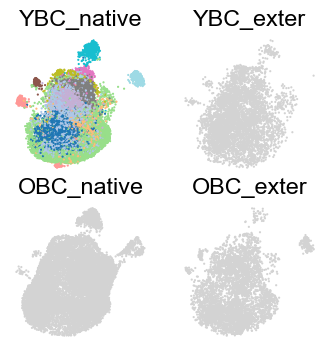

In [343]:
fig, ax = plt.subplots(2, 2, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
for i, attr in enumerate(['YBC_native', 'YBC_exter', 'OBC_native', 'OBC_exter']):
  x, y = int(i/2), i%2
  sc.pl.umap(adata_Mye[adata_Mye.obs['attr']==attr], color=['anno-Mye'],
             palette='tab20', size=10,title=attr, ax=ax[x][y], show=False)
  ax[x][y].spines['right'].set_visible(False)
  ax[x][y].spines['top'].set_visible(False)
  ax[x][y].spines['left'].set_visible(False)
  ax[x][y].spines['bottom'].set_visible(False)
  ax[x][y].set_xlabel("")
  ax[x][y].set_ylabel("")
  ax[x][y].legend_.set_visible(False)

In [ ]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation'):
  """
  使用 Memento 包分析单细胞测序数据中的动态变化。

  Args:
      adata (ad.AnnData): 单细胞测序数据的 AnnData 对象,adata.X requires raw data。
      ctleft (list): 左条件列表，表示刺激前的细胞类型或状态。
      ctright (list): 右条件列表，表示刺激后的细胞类型或状态。
      groupby (str, optional): 用于分组的注释列名。默认为 'annotation'。

  Returns:
      pd.DataFrame: Memento 分析的结果，包括差异表达分析、HT 1D moments 分析等。

  """
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  _adata = ad.AnnData(_adata.X, obs = _adata.obs, var = _adata.var)
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.7)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)

import scanpy as sc
import gseapy as gp
from gseapy import Msigdb
def prep_enrichr(adata, groupby):
  # de analysis
  sc.tl.rank_genes_groups(adata, groupby=groupby)
  sc.tl.dendrogram(adata, groupby=groupby)
  # get deg result
  result = adata.uns['rank_genes_groups']
  groups = result['names'].dtype.names
  degs = pd.DataFrame(
      {group + '_' + key: result[key][group]
      for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})
  return degs

def run_enrichr_genelist(genelist):
  kegg = gp.enrichr(genelist,
                  gene_sets='KEGG_2021_Human',
                  outdir=None)
  cc = gp.enrichr(genelist,
                      gene_sets='GO_Cellular_Component_2023',
                      outdir=None)
  hm = gp.enrichr(genelist,
                      gene_sets=['MSigDB_Hallmark_2020'],
                      outdir=None)
  mf = gp.enrichr(genelist,
                      gene_sets='GO_Molecular_Function_2023',
                      outdir=None)
  bp = gp.enrichr(genelist,
                      gene_sets=['GO_Biological_Process_2023'],
                      outdir=None)
  return kegg, cc, hm, mf, bp

def run_enrichr_scanpy(degs, group,direction='up', top_term=15, all_term=False, plot=True, threshold=0.5):
  # subset up or down regulated genes
  degs_sig = degs[degs[f'{group}_pvals_adj'] < 0.05]
  degs_up = degs_sig[degs_sig[f'{group}_logfoldchanges'] > threshold]
  degs_dw = degs_sig[degs_sig[f'{group}_logfoldchanges'] < -threshold]
  degs_used = degs_up[f'{group}_names'] if direction == 'up' else degs_dw[f'{group}_names']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(top_term),
                    hm.res2d.head(top_term), 
                    cc.res2d.head(top_term), 
                    bp.res2d.head(top_term), 
                    mf.res2d.head(top_term)])
  if plot:
    ax = gp.barplot(go_res, figsize=(6,20),
                group ='Gene_set',
                top_term=top_term,
                color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
                title ="The Most Enriched Terms")
  else:
    ax = None
  if all_term:
    go_res = pd.concat([kegg.res2d, hm.res2d, cc.res2d, bp.res2d, mf.res2d])
  return go_res, ax
  
def run_enrichr_memento(memento_results,direction='up', top_term=15):
  memento_sig = memento_results[memento_results['de_pval'] < 0.05]
  memento_up = memento_sig[memento_sig['de_coef'] > 0]
  memento_dw = memento_sig[memento_sig['de_coef'] < 0]
  degs_used = memento_up['gene'] if direction == 'up' else memento_dw['gene']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(15),
                      hm.res2d.head(15), 
                      cc.res2d.head(15), 
                      bp.res2d.head(15), 
                      mf.res2d.head(15)])
  ax = gp.barplot(go_res, figsize=(6,20),
              group ='Gene_set',
              top_term=top_term,
              color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
              title ="The Most Enriched Terms")
  return go_res, ax

In [ ]:
adata_Mye.obs['anno-Mye-all'].cat.categories

Index(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',
       'C05_Mac5_Myo', 'C06_Monocyte', 'C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC', 'C13_Mac6', 'C14_TEX14'],
      dtype='object')

In [ ]:
# DEGs of young and non-young in each subtype
DEGs = {}
ctleft = ["Young"]
ctright = ['Non-young']
for ct in adata_Mye.obs['anno-Mye-all'].cat.categories:
  DEGs[ct] = DE_memento_1d(adata_Mye[adata_Mye.obs['anno-Mye-all'].isin([ct])], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='age')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [ ]:
ctleft = ["Young"]
ctright = ['Non-young']
DEGs["All"] = DE_memento_1d(adata_Mye, 
                        ctleft = ctleft, 
                        ctright = ctright, 
                        groupby='age')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [ ]:
de_attr = DEGs['All']

In [ ]:
%%R -i de_attr
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(de_attr, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_Mye_Age.pdf", p, width = 3, height = 3, units = "in")

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ lubridate 1.9.3     ✔ tibble    3.2.1
✔ purrr     1.0.2     ✔ tidyr     1.3.1
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ lubridate::%--%()      masks igraph::%--%()
✖ lubridate::%within%()  masks IRanges::%within%()
✖ dplyr::as_data_frame() masks tibble::as_data_frame(), igraph::as_data_frame()
✖ dplyr::collapse()      masks IRanges::collapse()
✖ dplyr::combine()       masks Biobase::combine(), BiocGenerics::combine()
✖ purrr::compose()       masks igraph::compose()
✖ dplyr::count()         masks matrixStats::count()
✖ tidyr::crossing()      masks igraph::crossing()
✖ dplyr::desc()          masks IRanges::desc()
✖ tidyr::expand()        masks Matrix::expand(), S4Vectors::expand()
✖ dplyr::filter()        masks stats::filter()
✖ dplyr::first()         masks S4Vectors::first()
✖ dplyr::la

Loading required package: tidyverse


In [ ]:
m1_genes = [
    "TNF",  # 肿瘤坏死因子
    "IL1B",  # 白介素1β
    "IL6",  # 白介素6
    "CXCL10",  # C-X-C基序趋化因子配体10
    "CCL2",  # C-C基序趋化因子配体2
    "NOS2",  # 诱导型一氧化氮合酶
    "IRF5",  # 干扰素调节因子5
    "STAT1"  # 信号转导和转录激活因子1
]

# M2极化相关基因集
m2_genes = [
    "IL10",  # 白介素10
    "TGFB1",  # 转化生长因子β1
    "ARG1",  # 精氨酸酶1
    "MRC1",  # 甘露糖受体C类型1
    "CD163",  # CD163分子
    "PPARG",  # 过氧化物酶体增殖物激活受体γ
    "STAT6"  # 信号转导和转录激活因子6
]

In [ ]:
sc.tl.score_genes(adata_YBC_native_Mye, gene_list=m1_genes, score_name='M1 score')
sc.tl.score_genes(adata_YBC_native_Mye, gene_list=m2_genes, score_name='M2 score')

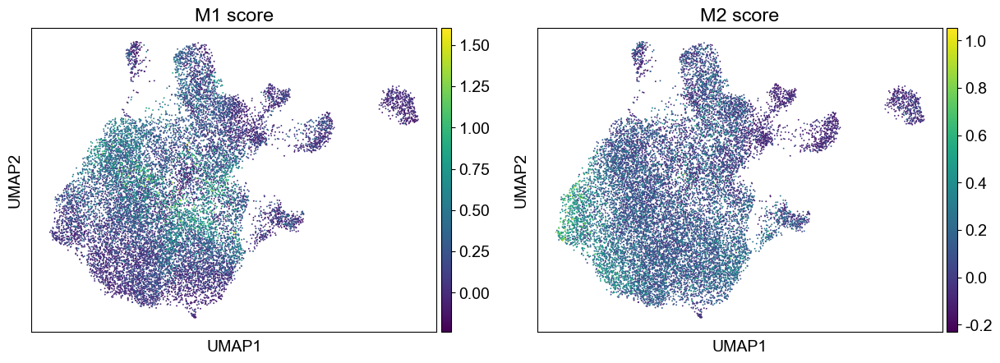

In [ ]:
sc.pl.umap(adata_YBC_native_Mye, color=['M1 score', 'M2 score'])

In [ ]:
adata_Mye.obs['anno-Mye-all'].cat.categories

Index(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',
       'C05_Mac5_Myo', 'C06_Monocyte', 'C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC', 'C13_Mac6', 'C14_TEX14'],
      dtype='object')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the 

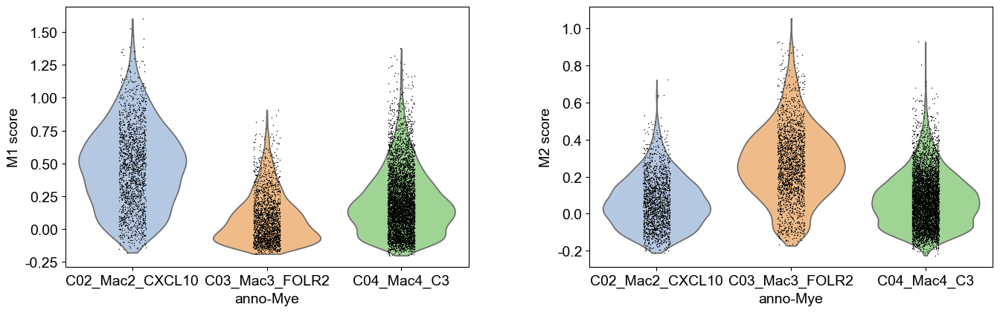

In [ ]:
sc.pl.violin(adata_YBC_native_Mye[adata_YBC_native_Mye.obs['anno-Mye'].isin(['C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',])], keys=['M1 score', 'M2 score'], groupby='anno-Mye')

In [ ]:
from scipy import stats
from statsmodels.stats.multicomp import pairwise_tukeyhsd
def Gexplot_adata(adata, gene, ax, group='treatment'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  sc.pl.violin(adata, keys=[gene], groupby=group, width=.6, ax=ax, show=False)
  groups = data.groupby(group).agg(list)
  group_names = list(data[group].unique())
  f_statistic, pval = stats.f_oneway(groups.loc[group_names[0], gene], 
                                        groups.loc[group_names[1], gene],
                                        groups.loc[group_names[2], gene],
                                        groups.loc[group_names[3], gene],
                                        groups.loc[group_names[4], gene])
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  # 根据 p 值判断是否拒绝原假设
  alpha = 0.05
  if pval < alpha:
      print("拒绝原假设，至少有一组均值与其他组有显著差异。")
      # 进行 Tukey's HSD 配对检验
      tukey = pairwise_tukeyhsd(endog=data[gene], groups=data[group], alpha=alpha)
      print("\nTukey's HSD 配对检验结果:")
      print(tukey)
  else:
      print("不能拒绝原假设，各组均值没有显著差异。")
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.3))
  # sns.lineplot(x=[0, 1], y=max(data[gene])+0.3, color='black', linewidth=1.2, ax=ax)
  # ax.text(0.5, max(data[gene])+0.3, f"ANOVA F={f_statistic:.3f},p={pval:.2e}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
         Multiple Comparison of Means - Tukey HSD, FWER=0.05          
     group1          group2     meandiff p-adj   lower   upper  reject
----------------------------------------------------------------------
  C01_Mac1_SPP1 C02_Mac2_CXCL10   0.3272    0.0  0.3072  0.3473   True
  C01_Mac1_SPP1  C03_Mac3_FOLR2  -0.0651    0.0 -0.0844 -0.0459   True
  C01_Mac1_SPP1     C04_Mac4_C3   0.0612    0.0  0.0461  0.0763   True
  C01_Mac1_SPP1    C05_Mac5_Myo  -0.1034    0.0  -0.136 -0.0708   True
C02_Mac2_CXCL10  C03_Mac3_FOLR2  -0.3923    0.0 -0.4141 -0.3706   True
C02_Mac2_CXCL10     C04_Mac4_C3   -0.266    0.0 -0.2842 -0.2479   True
C02_Mac2_CXCL10    C05_Mac5_Myo  -0.4306    0.0 -0.4647 -0.3965   True
 C03_Mac3_FOLR2     C04_Mac4_C3   0.1263    0.0  0.1091  0.1436   True
 C03_Mac3_FOLR2    C05_Mac5_Myo  -0.0383 0.0163 -0.0719 -0.0047   True
    C04_Mac4_C3    C05_Mac5_Myo  -0.1646    0.0  -0.196 -0.1332   True
--------------------------------

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(



Tukey's HSD 配对检验结果:
         Multiple Comparison of Means - Tukey HSD, FWER=0.05          
     group1          group2     meandiff p-adj   lower   upper  reject
----------------------------------------------------------------------
  C01_Mac1_SPP1 C02_Mac2_CXCL10  -0.0313    0.0 -0.0442 -0.0184   True
  C01_Mac1_SPP1  C03_Mac3_FOLR2    0.174    0.0  0.1616  0.1864   True
  C01_Mac1_SPP1     C04_Mac4_C3  -0.0178    0.0 -0.0275 -0.0081   True
  C01_Mac1_SPP1    C05_Mac5_Myo   -0.019 0.0966   -0.04   0.002  False
C02_Mac2_CXCL10  C03_Mac3_FOLR2   0.2053    0.0  0.1913  0.2193   True
C02_Mac2_CXCL10     C04_Mac4_C3   0.0136 0.0135  0.0019  0.0252   True
C02_Mac2_CXCL10    C05_Mac5_Myo   0.0123  0.545 -0.0097  0.0343  False
 C03_Mac3_FOLR2     C04_Mac4_C3  -0.1917    0.0 -0.2029 -0.1806   True
 C03_Mac3_FOLR2    C05_Mac5_Myo   -0.193    0.0 -0.2147 -0.1713   True
    C04_Mac4_C3    C05_Mac5_Myo  -0.0013 0.9998 -0.0215   0.019  False
--------------------------------------------------------

/tmp/ipykernel_626988/2121909709.py:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0].set_xticklabels(['Mac1', 'Mac2', 'Mac3', 'Mac4', 'Mac5'])
/tmp/ipykernel_626988/2121909709.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1].set_xticklabels(['Mac1', 'Mac2', 'Mac3', 'Mac4', 'Mac5'])


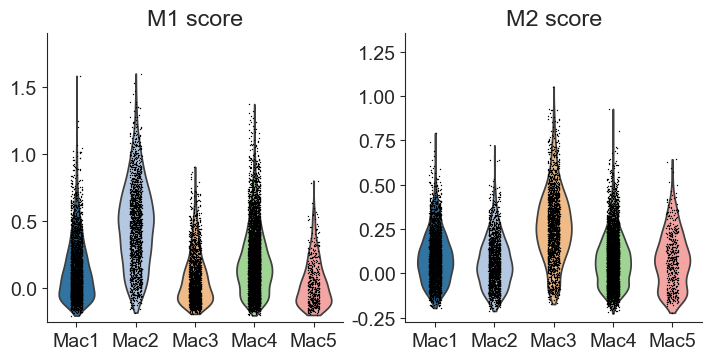

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(7,3.5), constrained_layout=True)
mdata = adata_YBC_native_Mye[adata_YBC_native_Mye.obs['anno-Mye'].isin(['C01_Mac1_SPP1','C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3','C05_Mac5_Myo'])]
ax[0] = Gexplot_adata(mdata, 'M1 score', ax=ax[0], group='anno-Mye')
ax[1] = Gexplot_adata(mdata, 'M2 score', ax=ax[1], group='anno-Mye')
ax[0].set_xlabel('')
ax[0].set_ylabel('')
ax[0].set_title('M1 score')
ax[0].set_xticklabels(['Mac1', 'Mac2', 'Mac3', 'Mac4', 'Mac5'])
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].set_title('M2 score')
ax[1].set_xticklabels(['Mac1', 'Mac2', 'Mac3', 'Mac4', 'Mac5'])
fig.savefig(f"{figPath}/Mye_M1M2score.pdf", bbox_inches='tight')

In [ ]:
# DEGs of young and non-young in each subtype
DEG_cells = {}
ctlist = ['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3', 'C05_Mac5_Myo']
for ct in ctlist:
  ctright = [ct]
  ctleft = [i for i in ctlist if i != ct]
  DEG_cells[ct] = DE_memento_1d(adata_YBC_native_Mye, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-Mye')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

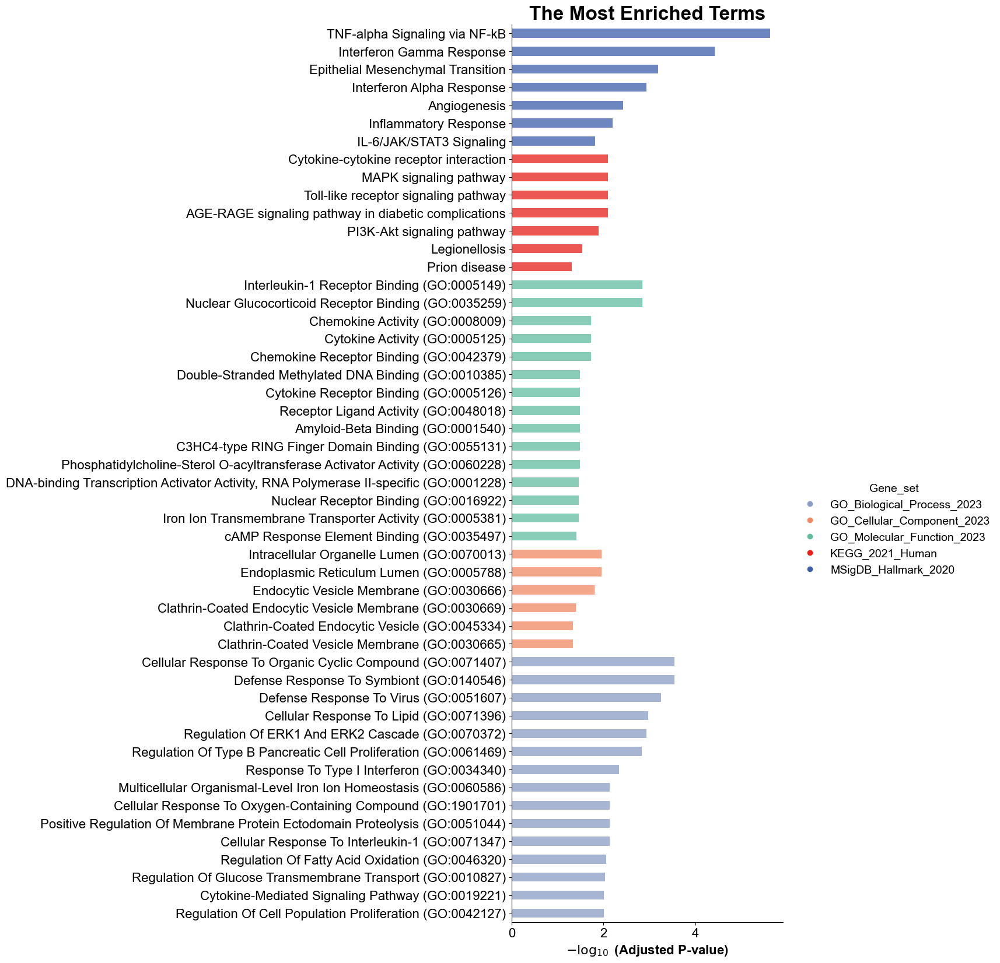

In [ ]:
GOs['Mac_Young'], ax = run_enrichr_memento(DEGs["Mac"], direction='down', top_term=15)

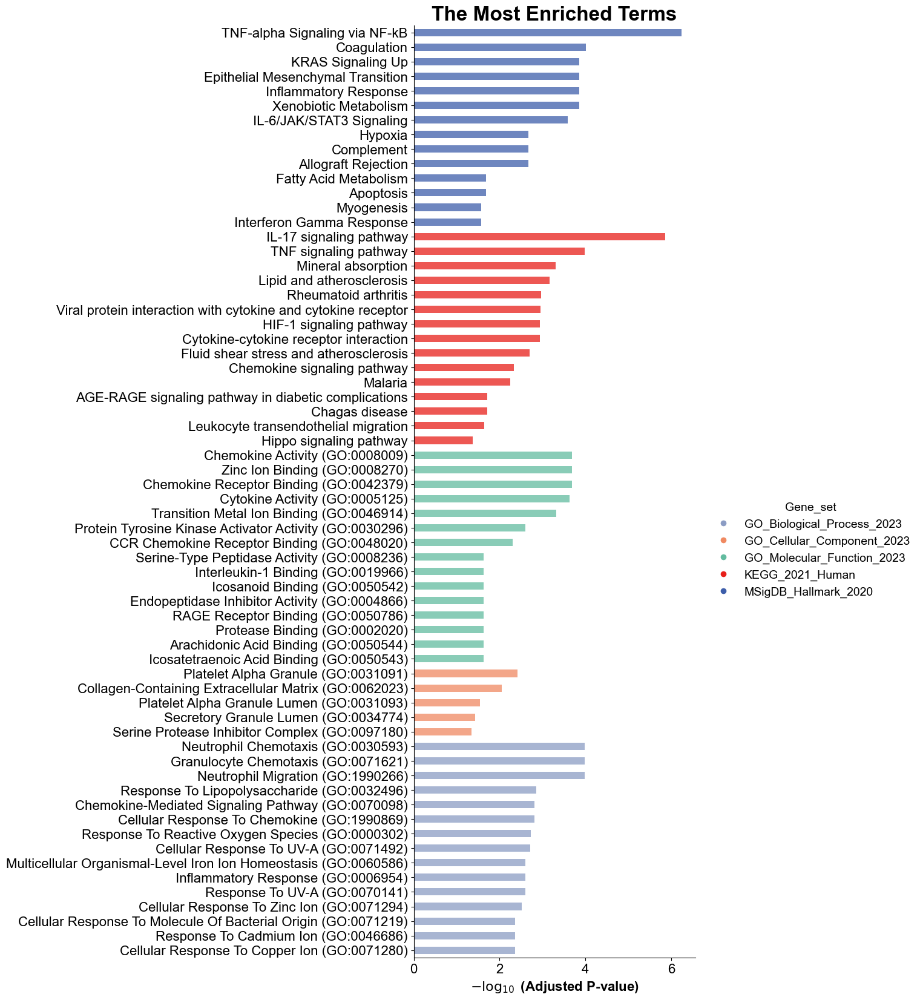

In [ ]:
GOs['Mac1'], ax = run_enrichr_memento(DEG_cells["C01_Mac1_SPP1"], direction='up', top_term=15)

In [ ]:
degs = prep_enrichr(adata_YBC_native_Mye, "anno-Mye")

In [ ]:
GOs={}

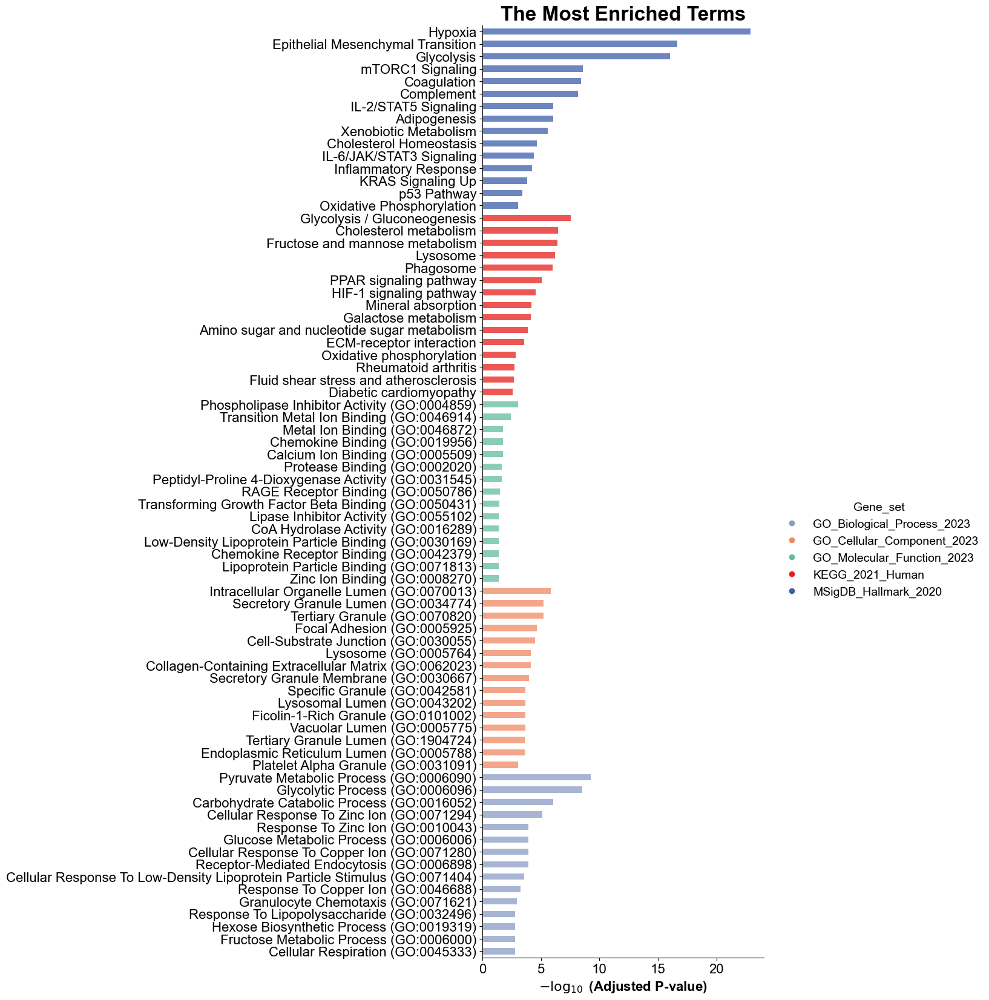

In [ ]:
GOs["C01_Mac1_SPP1"], ax = run_enrichr_scanpy(degs, "C01_Mac1_SPP1",direction='up', top_term=15, all_term=True, plot=True)

In [ ]:
gores_prefer = gores[gores['Term'].isin(prefer_pathway)]
gores_prefer = gores_prefer.sort_values(by=['Gene_set', 'Term', 'anno'])
gores_prefer = gores_prefer.reset_index(drop=True)
gores_prefer

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno
0,KEGG_2021_Human,Antigen processing and presentation,4/78,0.578575,0.971877,0.991446,0.542506,C01_Mac1_SPP1
1,KEGG_2021_Human,Antigen processing and presentation,12/78,0.000787,0.007391,3.274462,23.404643,C02_Mac2_CXCL10
2,KEGG_2021_Human,Antigen processing and presentation,6/78,0.130049,0.445581,1.809673,3.691449,C03_Mac3_FOLR2
3,KEGG_2021_Human,Antigen processing and presentation,14/78,0.000005,0.000098,4.975454,60.959492,C04_Mac4_C3
4,KEGG_2021_Human,Antigen processing and presentation,1/78,0.999834,0.999996,0.109574,0.000018,C05_Mac5_Myo
...,...,...,...,...,...,...,...,...
280,MSigDB_Hallmark_2020,p53 Pathway,32/200,0.002600,0.006842,1.815603,10.807056,C08_cDC1
281,MSigDB_Hallmark_2020,p53 Pathway,30/200,0.000202,0.001009,2.205341,18.764522,C09_cDC2
282,MSigDB_Hallmark_2020,p53 Pathway,38/200,0.037370,0.083918,1.417084,4.657786,C10_LC
283,MSigDB_Hallmark_2020,p53 Pathway,32/200,0.005693,0.023721,1.712364,8.850372,C11_mDC


/tmp/ipykernel_626988/3099942848.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['SPP1+', 'CXCL10+', 'FOLR2+', 'C3+', 'Myo', 'Mono', 'Neu', 'cDC1', 'cDC2', 'LC', 'mDC', 'pDC'],rotation=90, fontsize=11)
/tmp/ipykernel_626988/3099942848.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(),rotation=0, fontsize=9)


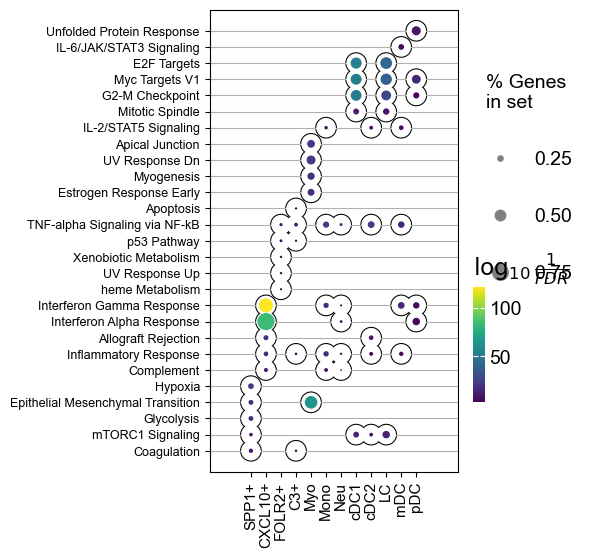

In [ ]:
from gseapy.scipalette import SciPalette
sci = SciPalette()
NbDr = sci.create_colormap() 
ax = gp.dotplot(gores[gores['Gene_set'].isin(['MSigDB_Hallmark_2020'])],figsize=(4,6),
                x='anno',
                title="",
                size=2.5,
                cmap='viridis',
                top_term=5,
                show_ring=True)
ax.set_xticklabels(['SPP1+', 'CXCL10+', 'FOLR2+', 'C3+', 'Myo', 'Mono', 'Neu', 'cDC1', 'cDC2', 'LC', 'mDC', 'pDC'],rotation=90, fontsize=11)
ax.set_yticklabels(ax.get_yticklabels(),rotation=0, fontsize=9)
ax.set_xlabel('')
ax.figure.savefig(f"{figPath}/Mye_MSigDB_Hallmark_2020.svg", bbox_inches='tight')

In [ ]:
gores_list = []

In [ ]:
adata_YBC_native_Mye.obs['anno-Mye'].cat.categories

Index(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',
       'C05_Mac5_Myo', 'C06_Monocyte', 'C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC'],
      dtype='object')

In [ ]:
gores_list

[                       Gene_set  \
 0               KEGG_2021_Human   
 1               KEGG_2021_Human   
 2               KEGG_2021_Human   
 3               KEGG_2021_Human   
 4               KEGG_2021_Human   
 ..                          ...   
 619  GO_Molecular_Function_2023   
 620  GO_Molecular_Function_2023   
 621  GO_Molecular_Function_2023   
 622  GO_Molecular_Function_2023   
 623  GO_Molecular_Function_2023   
 
                                                   Term  Overlap       P-value  \
 0                         Glycolysis / Gluconeogenesis    20/67  8.856351e-11   
 1                               Cholesterol metabolism    16/50  2.168795e-09   
 2                      Fructose and mannose metabolism    13/33  3.812172e-09   
 3                                             Lysosome   25/128  7.829051e-09   
 4                                            Phagosome   27/152  1.691448e-08   
 ..                                                 ...      ...          

In [ ]:

cell_types = ['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',]
for ct in cell_types:
  print("Running enrichment for {}...".format(ct))
  go_res, _ = run_enrichr_scanpy(degs, ct,direction='up', top_term=15, all_term=True, plot=False)
  go_res = go_res =  go_res[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
  go_res['anno'] = ct
  gores_list.append(go_res)
gores = pd.concat(gores_list, axis=0, ignore_index=True)
gores

Running enrichment for C01_Mac1_SPP1...
Running enrichment for C02_Mac2_CXCL10...
Running enrichment for C03_Mac3_FOLR2...
Running enrichment for C04_Mac4_C3...


,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno
0,KEGG_2021_Human,Focal adhesion,79/201,8.112051e-27,2.360607e-24,5.658737,3.399568e+02,C05_Mac5_Myo
1,KEGG_2021_Human,ECM-receptor interaction,45/88,1.974150e-21,2.872388e-19,9.034833,4.307280e+02,C05_Mac5_Myo
2,KEGG_2021_Human,PI3K-Akt signaling pathway,88/354,9.584028e-15,9.296507e-13,2.880353,9.297399e+01,C05_Mac5_Myo
3,KEGG_2021_Human,Rap1 signaling pathway,62/210,2.342232e-14,1.703974e-12,3.625181,1.137766e+02,C05_Mac5_Myo
4,KEGG_2021_Human,Pathways in cancer,115/531,3.223378e-14,1.876006e-12,2.418628,7.513652e+01,C05_Mac5_Myo
...,...,...,...,...,...,...,...,...
60034,GO_Molecular_Function_2023,Ubiquitin-Protein Transferase Activity (GO:000...,9/412,9.924467e-01,9.999960e-01,0.495972,3.760428e-03,C04_Mac4_C3
60035,GO_Molecular_Function_2023,Zinc Ion Binding (GO:0008270),6/341,9.968735e-01,9.999960e-01,0.397794,1.245655e-03,C04_Mac4_C3
60036,GO_Molecular_Function_2023,mRNA Binding (GO:0003729),2/282,9.999387e-01,9.999960e-01,0.158360,9.703763e-06,C04_Mac4_C3
60037,GO_Molecular_Function_2023,RNA Binding (GO:0003723),14/1411,9.999942e-01,9.999960e-01,0.212016,1.224752e-06,C04_Mac4_C3


In [ ]:
prefer_pathway = ['TNF-alpha Signaling via NF-kB', 'Apoptosis', 'Hypoxia', 'p53 Pathway','Glycolysis',
                  'IL-2/STAT5 Signaling', 'Estrogen Response Early', 'Estrogen Response Late',
                  'TGF-beta Signaling', 'T cell receptor signaling pathway', 'MAPK signaling pathway',
                  'IL-17 signaling pathway', 'Inflammatory Response', 'Myc Targets V1',
                  'Interferon Gamma Response', 'Interferon Alpha Response', 'Allograft Rejection',
                  'Oxidative Phosphorylation', 'Antigen processing and presentation',
                  'G2-M Checkpoint', 'E2F Targets', 'PI3K/AKT/mTOR  Signaling', 'Epithelial Mesenchymal Transition']

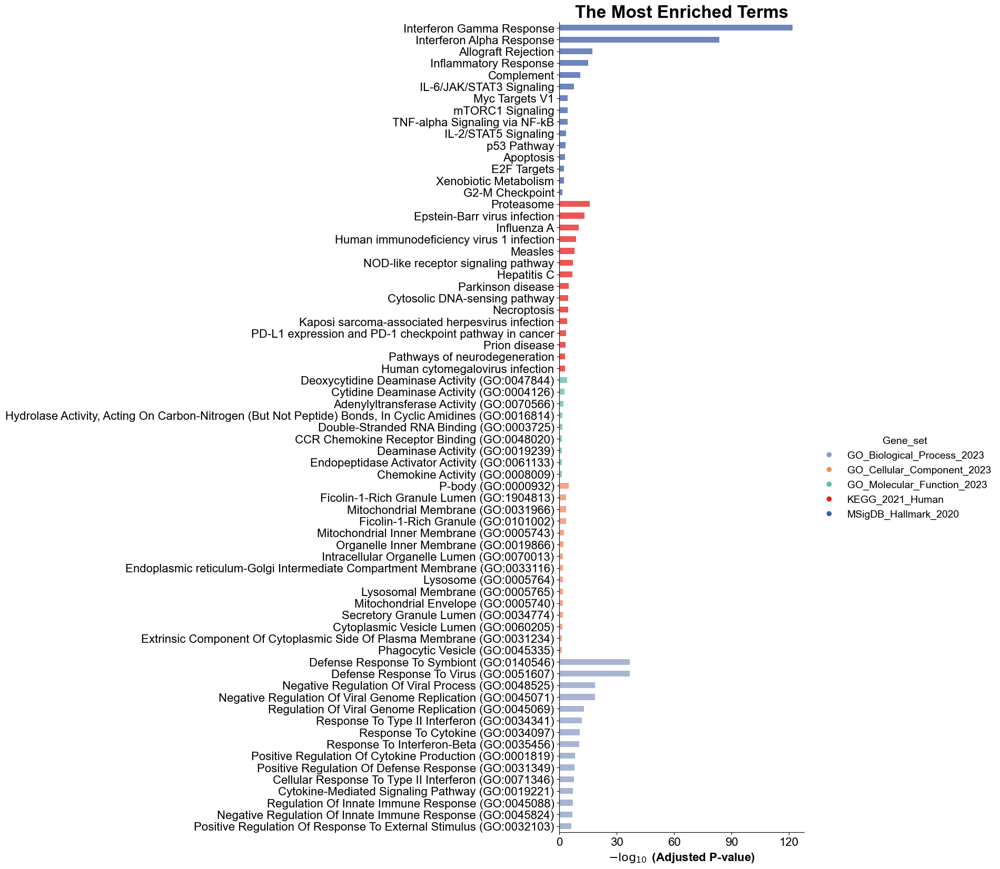

In [ ]:
GOs["C02_Mac2_CXCL10"], ax = run_enrichr_scanpy(degs, "C02_Mac2_CXCL10",direction='up', top_term=15, all_term=True, plot=True)

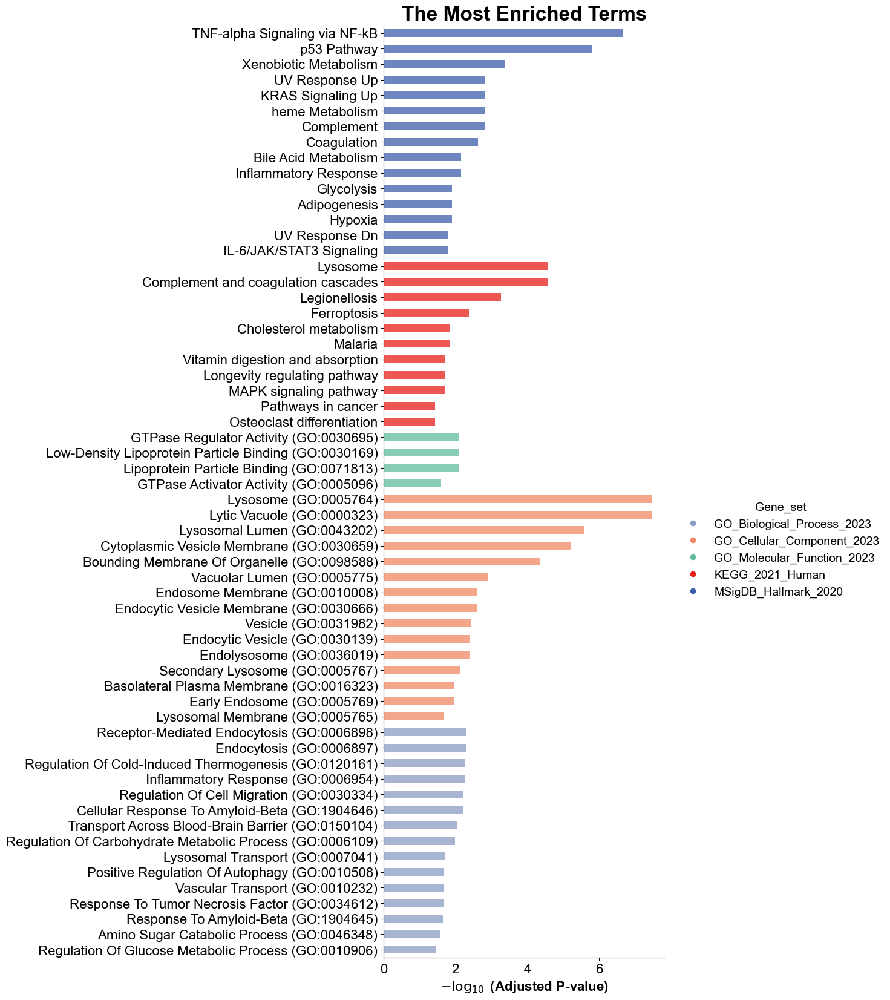

In [ ]:
GOs["C03_Mac3_FOLR2"], ax = run_enrichr_scanpy(degs, "C03_Mac3_FOLR2",direction='up', top_term=15, all_term=True, plot=True)

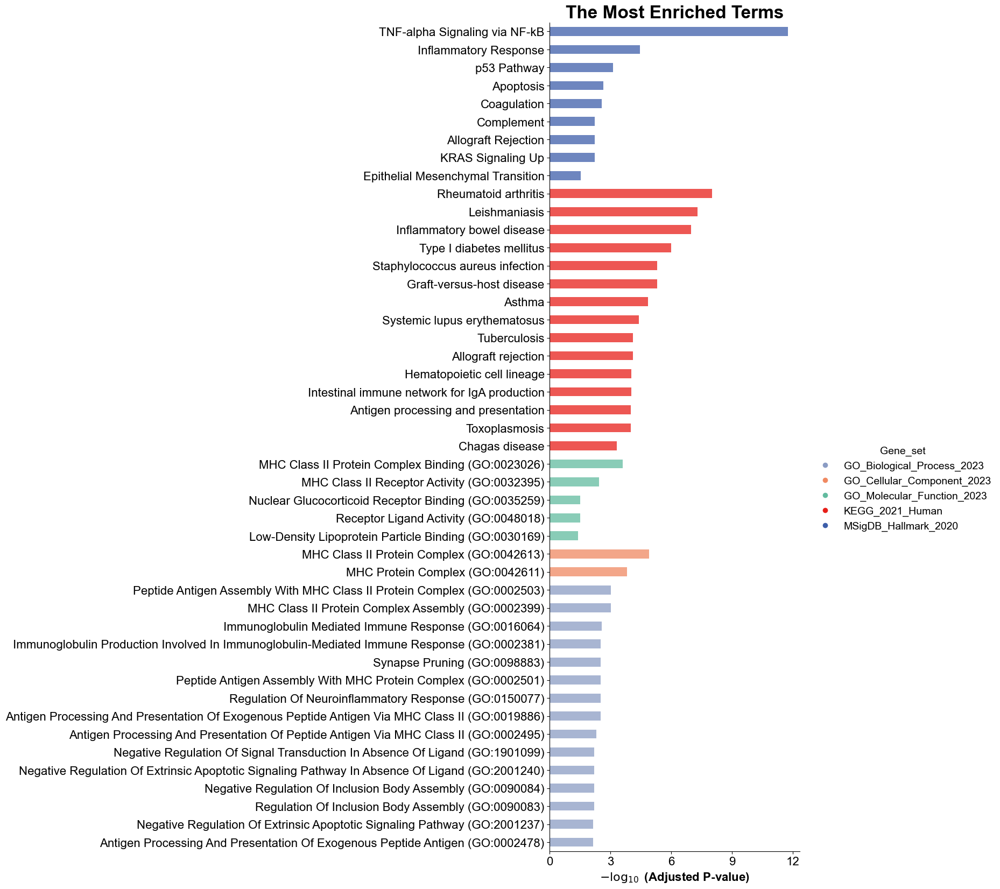

In [ ]:
GOs["C04_Mac4_C3"], ax = run_enrichr_scanpy(degs, "C04_Mac4_C3",direction='up', top_term=15, all_term=True, plot=True)

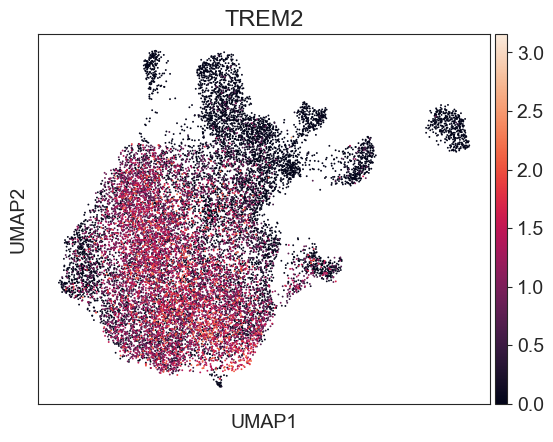

In [ ]:
sc.pl.umap(adata_YBC_native_Mye, color=['TREM2'])

In [ ]:
GOs["C01_Mac1_SPP1"][GOs["C01_Mac1_SPP1"]['Term'] == 'PI3K-Akt signaling pathway']

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
171,KEGG_2021_Human,PI3K-Akt signaling pathway,18/354,0.563584,0.971877,0,0,0.982319,0.563299,ITGB1;ITGB5;ITGA3;ITGB3;ITGA2;FN1;TNC;GNG12;TH...


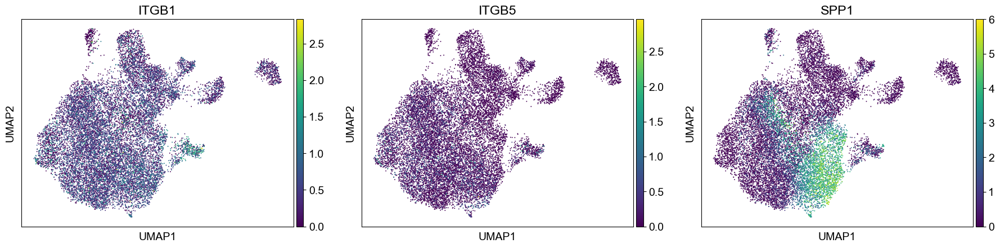

In [ ]:
sc.pl.umap(adata_YBC_native_Mye, color=['ITGB1', 'ITGB5', 'SPP1'])

In [ ]:
adata_CD8T = sc.read_h5ad("adata-CD8T-3.3.h5ad")
adata_CD8T.obs['anno-CD8T'].cat.categories

Index(['C01_Trm_XCL1', 'C02_Trm_IL7R', 'C03_Trm_ISG15', 'C04_Teff_IFNG',
       'C05_Teff_GZMK', 'C06_NK_NCAM1', 'C07_NKT_FGFBP2', 'C08_cTex_ENTPD1',
       'C09_tTex_CD200', 'C10_Tprolif_MKI67'],
      dtype='object')

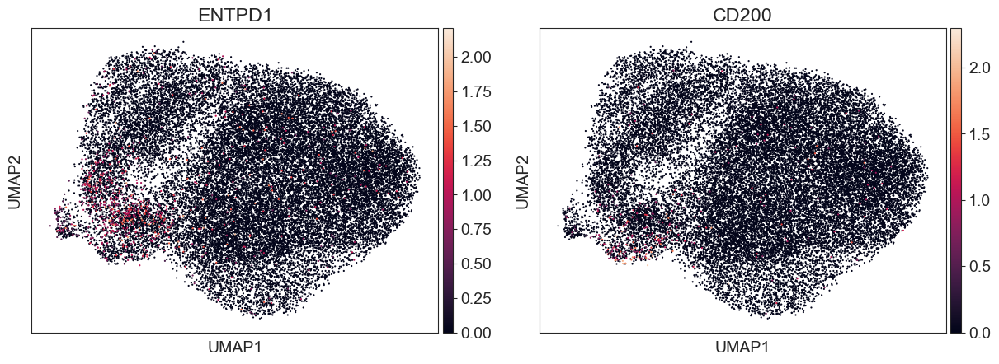

In [ ]:
sc.pl.umap(adata_CD8T, color=['ENTPD1', 'CD200'], use_raw=False, size=10)

In [ ]:
annot = {
  'C01_Tn/Tcm_CCR7': ['C02_Trm_IL7R'], 
  'C02_Tcm_ISG15': ['C03_Trm_ISG15'], 
  'C03_Teff_GZMK': ['C05_Teff_GZMK'], 
  'C04_Trm_XCL1': ['C01_Trm_XCL1'],
  'C05_pTex_IFNG': ['C04_Teff_IFNG'],
  'C06_tTex_early': ['C08_cTex_ENTPD1'],
  'C07_tTex_late': ['C09_tTex_CD200'], 
  'C08_Tprolif_MKI67': ['C10_Tprolif_MKI67'],
  'C09_NK_NCAM1': ['C06_NK_NCAM1'], 
  'C10_NKT_FGFBP2': ['C07_NKT_FGFBP2'], 
}
adata_CD8T = anno(adata_CD8T, annot, 'anno-newCD8T', 'anno-CD8T')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


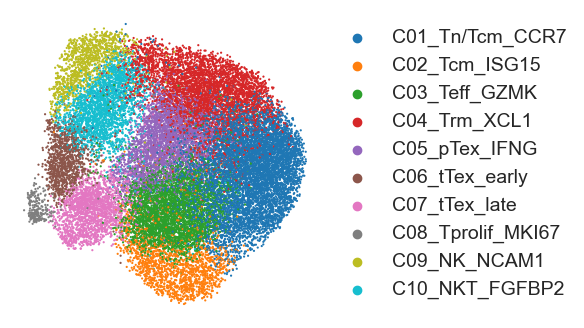

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T, color=['anno-newCD8T'], size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/4a-anno_CD8T.png', dpi=400, bbox_inches='tight')

In [ ]:
adata_CD8T.write_h5ad("adata-CD8T-5.17.h5ad")

In [ ]:
del adata_CD8T